In [1258]:
%matplotlib inline

In [1260]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from scipy import stats
import plotly.graph_objects as go

# Task 1 - Elo Rating

The development of a rating system is a common task in sport. Particularly, the [ELO rating system](https://en.wikipedia.org/wiki/Elo_rating_system#Formal_derivation_for_win/loss_games) is a particular popular one.

## a. Develop a function to implement the ELO Rating System with arbitrary *K* and *s*.

- *K*-factor := maximum possible adjustment per game
- *s* := scaling factor

### (i) For win/loss games for both players/teams

*R<sub>A</sub>* <- *R<sub>A</sub>* + *K*(*S<sub>A</sub>* - *E<sub>A</sub>*) 

- where *S<sub>A</sub>* = 1 if **A** wins and *S<sub>A</sub>* = 0 if **B** wins
- and the expected score is given by *E<sub>A</sub>* = 1 / (1 + 10<sup>(*R<sub>B</sub>*-*R<sub>A</sub>*)/s</sup>)

In [454]:
# Parameters are specified for test purposes
RA = 1613
RB = 1609
#RB = [1609, 1477, 1388, 1586, 1720]
K = 32
s = 400

# Specify the result of the game as a score for player/team A
SA = 1
#SA = np.sum([0, 0.5, 1, 1, 0])

In [456]:
def update_elo_ranking(RA, RB, K, s, SA, verbose=False):
    """
    Calculate the new ELO rating for a player after a win/loss match.

    Parameters:
    RA (float): Current ELO rating of the player/team.
    RB (float): Current ELO rating of the opponent player/team.
    K (int): K-factor for the match.
    s (int): The divisor used in the rating difference calculation. 
    SA (float): Outcome of the match (1 for win, 0.5 for draw, 0 for loss).
   

    Returns:
    float: Updated ELO rating of the player/team A.
    float: Updated ELO rating of the player/team B.
    """

    # calutate the expected scores
    EA = np.sum(1 / (1 + 10 ** ((np.subtract(RB,RA)/s))))
    EB = np.sum(1 / (1 + 10 ** ((np.subtract(RA,RB)/s))))

    if verbose: 
        print(f"Expected score for player A: {EA} and player B: {EB}")

    # update ELO ranking for player A
    RA_ = RA + K * (SA - EA)

    # update ELO ranking for player B (score is the reciprocal value for Player A)
    SB = np.sum(np.subtract(1, SA))
    RB_ = RB + K * (SB - EB)

    if verbose:       
        game_result_team_a = "wins" if SA == 1 else "loses"
        print(f"\n\tTeam A {game_result_team_a}")
        
        print(f"Old rating for player A: {RA} ; NEW rating for player A: {RA_}")
        print(f"Old rating for player B: {RB} ; NEW rating for player B: {RB_}")

    return RA_, RB_

update_elo_ranking(RA, RB, K, s, SA, verbose=True)

Expected score for player A: 0.5057562084111449 and player B: 0.49424379158885506

	Team A wins
Old rating for player A: 1613 ; NEW rating for player A: 1628.8158013308434
Old rating for player B: 1609 ; NEW rating for player B: 1593.1841986691566


(1628.8158013308434, 1593.1841986691566)

### (ii) For win/draw/loss games for both players/teams

*R<sub>A</sub>* <- *R<sub>A</sub>* + *K*($\hat{S}$<sub>A</sub> - *E<sub>A</sub>*)

- where $\hat{S}$<sub>A</sub> = *S<sub>A</sub>* +0.5*D* and $\hat{S}$<sub>A</sub> = 1 if **A** wins and $\hat{S}$<sub>A</sub> = 0.5 if *A* draws, and $\hat{S}$<sub>A</sub> = 0 if **B** loses
- and the expected score is given by *E<sub>A</sub>* = *g(r<sub>A,b</sub> ; $\kappa$*) (using $\kappa$ = the Elo-Davidson rating is exactly the same as the Elo rating)

In [459]:
# Parameters are specified for test purposes
RA = 1613
RB = 1609
#RB = [1609, 1477, 1388, 1586, 1720]
K = 32
s = 400
kappa = 2 # (using κ = 2, the Elo-Davidson rating is exactly the same as the Elo rating)

# Specify the result of the game as a score for player/team A
SA = 1
#SA = np.sum([0, 0.5, 1, 1, 0])

In [461]:
def update_elo_davidson_rating(RA, RB, K, s, SA, kappa, verbose=False):
    """
    Calculate the new ELO rating for a player after a win/loss match.

    Parameters:
    RA (float): Current ELO rating of the player/team.
    RB (float): Current ELO rating of the opponent player/team.
    K (int): K-factor for the match.
    s (int): The divisor used in the rating difference calculation. 
    SA (float): Outcome of the match (1 for win, 0.5 for draw, 0 for loss).
    kappa (int): Weight for draw event. 

    Returns:
    float: Updated ELO rating of the player/team A.
    float: Updated ELO rating of the player/team B.
    """

    # calutate the expected scores
    EA = (10 ** (np.subtract(RA,RB)/s) + kappa/2) / ( (10 ** (np.subtract(RB,RA)/s)) + kappa + (10 ** (np.subtract(RA,RB)/s)) ) 
    EB = (10 ** (np.subtract(RB,RA)/s) + kappa/2) / ( (10 ** (np.subtract(RA,RB)/s)) + kappa + (10 ** (np.subtract(RB,RA)/s)) ) 

    if verbose:
        print(f"Expected score for player A: {EA} and player B: {EB}")

    # update ELO ranking for player A
    RA_ = RA + K * (SA - EA)

    # update ELO ranking for player B (score is the reciprocal value for Player A)
    SB = np.sum(np.subtract(1, SA))
    RB_ = RB + K * (SB - EB)

    if verbose:
        game_result_team_a = "wins" if SA == 1 else "loses"
        print(f"\n\tTeam A {game_result_team_a}")
        
        print(f"Old rating for team A: {RA} ; NEW rating for team A: {RA_}")
        print(f"Old rating for team B: {RB} ; NEW rating for team B: {RB_}")

    return RA_, RB_

update_elo_davidson_rating(RA, RB, K, s, SA, kappa, verbose=True)

Expected score for player A: 0.5057562084111449 and player B: 0.49424379158885506

	Team A wins
Old rating for team A: 1613 ; NEW rating for team A: 1628.8158013308434
Old rating for team B: 1609 ; NEW rating for team B: 1593.1841986691566


(1628.8158013308434, 1593.1841986691566)

## b. Apply the rating system to 1. Bundesliga 2015/2016 Season with starting values *R<sub>0</sub>* = 100, *s* = 15 and *K* = 15.

- 1. Bundesliga has **competition_id = 9**
- Season 2015/2016 has **season_id = 27**

In [464]:
df = pd.read_json("./open-data-master/data/matches/9/27.json")

df.head()

,match_id,match_date,kick_off,competition,season,home_team,away_team,home_score,away_score,match_status,match_status_360,last_updated,last_updated_360,metadata,match_week,competition_stage,stadium,referee
0,3890561,2016-05-14,15:30:00.000,"{'competition_id': 9, 'country_name': 'Germany...","{'season_id': 27, 'season_name': '2015/2016'}","{'home_team_id': 175, 'home_team_name': 'Hoffe...","{'away_team_id': 181, 'away_team_name': 'Schal...",1,4,available,unscheduled,2023-07-24T07:47:12.510532,NaN,"{'data_version': '1.1.0', 'shot_fidelity_versi...",34,"{'id': 1, 'name': 'Regular Season'}","{'id': 4541, 'name': 'PreZero Arena', 'country...","{'id': 186, 'name': 'Felix Brych', 'country': ..."
1,3890505,2016-04-02,15:30:00.000,"{'competition_id': 9, 'country_name': 'Germany...","{'season_id': 27, 'season_name': '2015/2016'}","{'home_team_id': 169, 'home_team_name': 'Bayer...","{'away_team_id': 184, 'away_team_name': 'Eintr...",1,0,available,unscheduled,2023-08-03T13:14:14.503553,NaN,"{'data_version': '1.1.0', 'shot_fidelity_versi...",28,"{'id': 1, 'name': 'Regular Season'}","{'id': 4867, 'name': 'Allianz Arena', 'country...","{'id': 1008758, 'name': 'Florian Meyer', 'coun..."
2,3890511,2016-04-08,20:30:00.000,"{'competition_id': 9, 'country_name': 'Germany...","{'season_id': 27, 'season_name': '2015/2016'}","{'home_team_id': 173, 'home_team_name': 'Herth...","{'away_team_id': 178, 'away_team_name': 'Hanno...",2,2,available,unscheduled,2023-08-06T05:50:38.345688,NaN,"{'data_version': '1.1.0', 'shot_fidelity_versi...",29,"{'id': 1, 'name': 'Regular Season'}","{'id': 367, 'name': 'Olympiastadion Berlin', '...","{'id': 235, 'name': 'Benjamin Brand', 'country..."
3,3890515,2016-04-09,15:30:00.000,"{'competition_id': 9, 'country_name': 'Germany...","{'season_id': 27, 'season_name': '2015/2016'}","{'home_team_id': 171, 'home_team_name': 'Hambu...","{'away_team_id': 872, 'away_team_name': 'Darms...",1,2,available,unscheduled,2023-07-18T17:52:17.363623,NaN,"{'data_version': '1.1.0', 'shot_fidelity_versi...",29,"{'id': 1, 'name': 'Regular Season'}","{'id': 379, 'name': 'Volksparkstadion', 'count...","{'id': 1008767, 'name': 'Peter Sippel', 'count..."
4,3890411,2015-12-20,16:30:00.000,"{'competition_id': 9, 'country_name': 'Germany...","{'season_id': 27, 'season_name': '2015/2016'}","{'home_team_id': 173, 'home_team_name': 'Herth...","{'away_team_id': 177, 'away_team_name': 'FSV M...",2,0,available,unscheduled,2023-07-16T13:47:06.565811,NaN,"{'data_version': '1.1.0', 'shot_fidelity_versi...",17,"{'id': 1, 'name': 'Regular Season'}","{'id': 367, 'name': 'Olympiastadion Berlin', '...","{'id': 1008767, 'name': 'Peter Sippel', 'count..."


In [465]:
df.columns

Index(['match_id', 'match_date', 'kick_off', 'competition', 'season',
       'home_team', 'away_team', 'home_score', 'away_score', 'match_status',
       'match_status_360', 'last_updated', 'last_updated_360', 'metadata',
       'match_week', 'competition_stage', 'stadium', 'referee'],
      dtype='object')

In [468]:
def set_score(series):
    """
    Determine the match score for ELO rate. 
    1 refers to home team win, 0.5 for a draw and 0 for home team loses.

    Parameters:
    series (pd.Series): Current pandas Series.

    Returns:
    float: Result for the match as a score.
    """
    
    if (series['home_score'] > series['away_score']):
        return 1
    elif (series['home_score'] == series['away_score']):
        return 0.5
    else:
        return 0

In [470]:
df_edited = (df
    .drop(['kick_off', 'competition', 'season', 'match_status', 'match_status_360', 'last_updated', 'last_updated_360', 'metadata', 'competition_stage', 'stadium', 'referee'], axis=1) # remove unnecessary columns
    .assign(home_team_id=lambda df_: df_.apply(lambda row: df_.loc[row.name, 'home_team']['home_team_id'], axis=1)) # get home team id
    .assign(home_team_name=lambda df_: df_.apply(lambda row: df_.loc[row.name, 'home_team']['home_team_name'], axis=1)) # get home team name
    .assign(away_team_id=lambda df_: df_.apply(lambda row: df_.loc[row.name, 'away_team']['away_team_id'], axis=1)) # get away team id
    .assign(away_team_name=lambda df_: df_.apply(lambda row: df_.loc[row.name, 'away_team']['away_team_name'], axis=1)) # away home team name
    .assign(SA=lambda df_: df_.apply(set_score, axis=1)) # calculate the score value for the home heam (1-SA applies analogously for the away team)
    .sort_values(by='match_week', ascending=True) # sort dataframe by match week
)    
                 
df_edited

,match_id,match_date,home_team,away_team,home_score,away_score,match_week,home_team_id,home_team_name,away_team_id,away_team_name,SA
305,3890259,2015-08-14,"{'home_team_id': 169, 'home_team_name': 'Bayer...","{'away_team_id': 171, 'away_team_name': 'Hambu...",5,0,1,169,Bayern Munich,171,Hamburger SV,1.0
297,3890267,2015-08-16,"{'home_team_id': 179, 'home_team_name': 'Wolfs...","{'away_team_id': 184, 'away_team_name': 'Eintr...",2,1,1,179,Wolfsburg,184,Eintracht Frankfurt,1.0
298,3890266,2015-08-16,"{'home_team_id': 174, 'home_team_name': 'VfB S...","{'away_team_id': 186, 'away_team_name': 'FC Kö...",1,3,1,174,VfB Stuttgart,186,FC Köln,0.0
300,3890264,2015-08-15,"{'home_team_id': 176, 'home_team_name': 'Werde...","{'away_team_id': 181, 'away_team_name': 'Schal...",0,3,1,176,Werder Bremen,181,Schalke 04,0.0
299,3890265,2015-08-15,"{'home_team_id': 172, 'home_team_name': 'Augsb...","{'away_team_id': 173, 'away_team_name': 'Herth...",0,1,1,172,Augsburg,173,Hertha Berlin,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
18,3890560,2016-05-14,"{'home_team_id': 872, 'home_team_name': 'Darms...","{'away_team_id': 185, 'away_team_name': 'Borus...",0,2,34,872,Darmstadt 98,185,Borussia Mönchengladbach,0.0
17,3890562,2016-05-14,"{'home_team_id': 180, 'home_team_name': 'Borus...","{'away_team_id': 186, 'away_team_name': 'FC Kö...",2,2,34,180,Borussia Dortmund,186,FC Köln,0.5
16,3890563,2016-05-14,"{'home_team_id': 904, 'home_team_name': 'Bayer...","{'away_team_id': 189, 'away_team_name': 'Ingol...",3,2,34,904,Bayer Leverkusen,189,Ingolstadt,1.0
15,3890564,2016-05-14,"{'home_team_id': 172, 'home_team_name': 'Augsb...","{'away_team_id': 171, 'away_team_name': 'Hambu...",1,3,34,172,Augsburg,171,Hamburger SV,0.0


### Initite the Ranking with R0

In [472]:
R0 = 100

match_week_R0 = [1]
team_ids = df_edited.home_team_id.unique()

n_teams = team_ids.size

In [474]:
df_elo_rating = pd.DataFrame({
    'match_week': match_week_R0 * n_teams,
    'team_id': team_ids,
    'R': n_teams * [R0]
})

outcomes = []
# iterate over each team_id and get the result for the initil match week (this step is only carried out if the sequence is not ordered)
for index, row in df_elo_rating.iterrows(): 
    team_id = row['team_id']
    try: # match with home team
        outcome = df_edited.query(f"match_week == 1 & home_team_id == {row['team_id']}")['SA'].values[0] 
    except: # match with away team (result is 1-outcome)
        outcome = 1-df_edited.query(f"match_week == 1 & away_team_id == {row['team_id']}")['SA'].values[0] 
    outcomes.append(outcome)

df_elo_rating['outcome'] = outcomes

df_elo_rating

,match_week,team_id,R,outcome
0,1,169,100,1.0
1,1,179,100,1.0
2,1,174,100,0.0
3,1,176,100,0.0
4,1,172,100,0.0
5,1,904,100,1.0
6,1,180,100,1.0
7,1,872,100,0.5
8,1,177,100,0.0
9,1,175,100,0.0


### Calculate the new ELO rating

In [477]:
s = 15
K = 15

#kappa = 2
verbose = False

In [479]:
%%time

# iterate over the match weeks, starting from the second match week
for match_week in range(2, 35):

    df_match_week = df_edited[df_edited['match_week'] == match_week]

    # iterate over each match
    for index, row in df_match_week.iterrows(): 
        home_team_id = row['home_team_id']
        away_team_id = row['away_team_id']

        RA = df_elo_rating.query(f"match_week == {match_week-1} & team_id == {home_team_id}")['R'].values[0] 
        RB = df_elo_rating.query(f"match_week == {match_week-1} & team_id == {away_team_id}")['R'].values[0] 

        SA = df_match_week.query(f"home_team_id == {home_team_id}")['SA'].values[0] 

        # calculate the new ELO rating (both calculations proved the same results as long kappa=2)
        #RA_, RB_ = update_elo_davidson_rating(RA, RB, K, s, SA, kappa, verbose=verbose)
        RA_, RB_ = update_elo_ranking(RA, RB, K, s, SA, verbose=verbose)

        if verbose:
            print(f"Match-week: {match_week} ; home-team-id: {home_team_id} with ELO-rate: {RA} and new ELO-rate: {RA_}" 
                + f"\n\t\taway-team-id: {away_team_id} with ELO-rate: {RB} and new ELO-rate: {RB_} --- match score: {SA}")

        # collect the new rating values together with the previous ones (away team outcome: 1 - home team)
        df_elo_rating.loc[len(df_elo_rating)] = [match_week, home_team_id, RA_, SA]
        df_elo_rating.loc[len(df_elo_rating)] = [match_week, away_team_id, RB_, 1-SA]
        
        #break
    #break    
  
df_elo_rating

CPU times: user 512 ms, sys: 7.86 ms, total: 520 ms
Wall time: 527 ms


,match_week,team_id,R,outcome
0,1.0,169.0,100.000000,1.0
1,1.0,179.0,100.000000,1.0
2,1.0,174.0,100.000000,0.0
3,1.0,176.0,100.000000,0.0
4,1.0,172.0,100.000000,0.0
...,...,...,...,...
607,34.0,189.0,86.198455,0.0
608,34.0,172.0,94.288349,0.0
609,34.0,171.0,96.830999,1.0
610,34.0,175.0,89.456963,0.0


In [481]:
df_elo_rating_ = (pd
                  .merge(left=df_elo_rating, right=df_edited[['home_team_id', 'home_team_name']], how='left', left_on='team_id', right_on='home_team_id')
                  .drop_duplicates()
                 )

df_elo_rating_

,match_week,team_id,R,outcome,home_team_id,home_team_name
0,1.0,169.0,100.000000,1.0,169,Bayern Munich
17,1.0,179.0,100.000000,1.0,179,Wolfsburg
34,1.0,174.0,100.000000,0.0,174,VfB Stuttgart
51,1.0,176.0,100.000000,0.0,176,Werder Bremen
68,1.0,172.0,100.000000,0.0,172,Augsburg
...,...,...,...,...,...,...
10319,34.0,189.0,86.198455,0.0,189,Ingolstadt
10336,34.0,172.0,94.288349,0.0,172,Augsburg
10353,34.0,171.0,96.830999,1.0,171,Hamburger SV
10370,34.0,175.0,89.456963,0.0,175,Hoffenheim


In [483]:
sns.set_theme(rc={'figure.figsize':(14., 9.)})

plt.rcParams['figure.figsize'] = 14, 6
plt.rcParams["legend.fontsize"] = 14
plt.rcParams["xtick.labelsize"] = 14
plt.rcParams["ytick.labelsize"] = 14

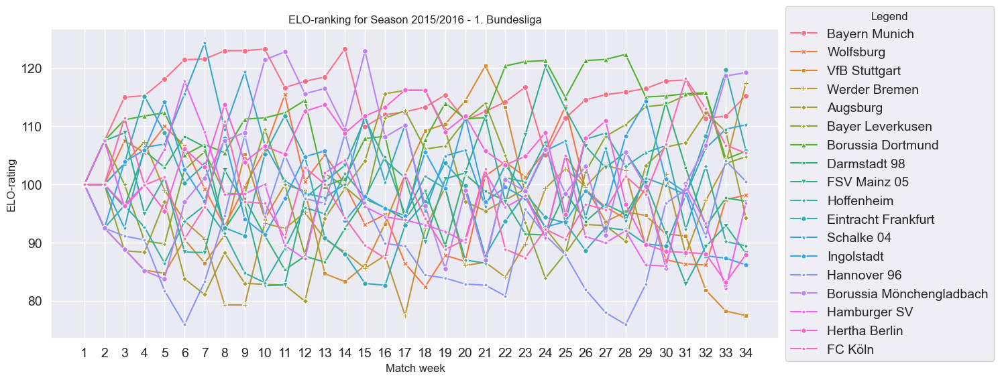

In [485]:
ax = sns.lineplot(data=df_elo_rating_, x="match_week", y="R", hue="home_team_name", style="home_team_name", 
             markers=True, dashes=False)

# Set title for the plot
ax.set_title("ELO-ranking for Season 2015/2016 - 1. Bundesliga")

# Customize x-axis ticks
ax.set_xticks(np.arange(1, 35))

# Place the legend outside the plot
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), title="Legend")

ax.set(xlabel='Match week', ylabel='ELO-rating')

plt.show()

### Plotly visualization has also been added, as this allows interactive queries within a figure and the values of certain data points can be read directly.

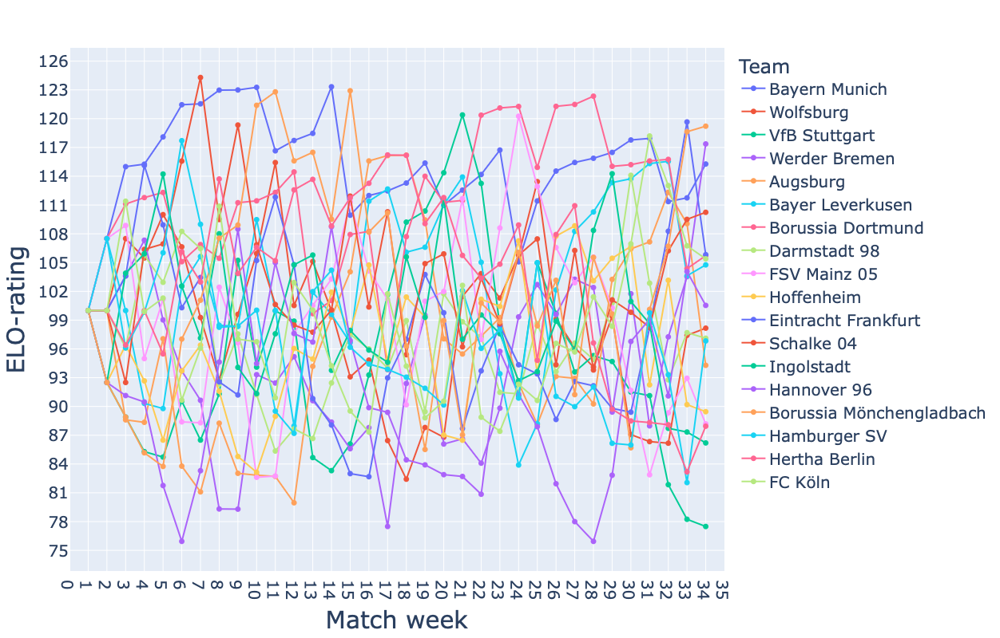

In [495]:
fig = px.line(df_elo_rating_, x="match_week", y="R", color="home_team_name", markers=True, width=1500, height=800)

# x-axis
fig.update_xaxes(
    title="Match week",
    title_font_size=30,
    tickfont=dict(size=20),
    dtick=1,
    range=[0, 35]
)

# y-axis
fig.update_yaxes(
    title="ELO-rating",
    title_font_size=30,
    tickfont=dict(size=20),
    dtick=3
)

# legend
fig.update_layout(
    legend_title="Team",
    legend=dict(
        yanchor="top",
        font=dict(size=20),
    )
)

# lines width and marker size
fig.update_traces(
    line=dict(width=2.),
    marker={'size': 7}
)
                
fig.show()

# save figure locally as html
#fig.write_html("./figures/Bundesliga2015-2016_ELO-ranking.html", include_plotlyjs="cdn")

### Observations:
- we see that teams that have the first/last 3 places in the ELO rating on the last matchday are not necessarily in the same place in the final table
- However, the example of the last matchday shows where teams have increased/decreased a lot in ELO because they won/lost in the last match against a previously better/worse opponent
    - Example: On match day 33: Hamburger SV - ELO: 82 wins on match day 34 against Augsburg with ELO from the previous match day: 109. After HSV's win, their ELO rises to 96.7 and Augsburg's drops to 94.3

## c. Develop an approach that finds the optimal values for *s* and *K* based on that season and display the final ranking table at the end of the season.

In [44]:
df_optimize_subset = df_edited[['match_week', 'home_team_id', 'home_team_name', 'away_team_id', 'away_team_name', 'SA']]

print(df_optimize_subset.shape)

df_optimize_subset.head()

(306, 6)


,match_week,home_team_id,home_team_name,away_team_id,away_team_name,SA
305,1,169,Bayern Munich,171,Hamburger SV,1.0
297,1,179,Wolfsburg,184,Eintracht Frankfurt,1.0
298,1,174,VfB Stuttgart,186,FC Köln,0.0
300,1,176,Werder Bremen,181,Schalke 04,0.0
299,1,172,Augsburg,173,Hertha Berlin,0.0


In [46]:
print(df_elo_rating_.shape)

df_elo_rating_.head()

(612, 6)


,match_week,team_id,R,outcome,home_team_id,home_team_name
0,1.0,169.0,100.0,1.0,169,Bayern Munich
17,1.0,179.0,100.0,1.0,179,Wolfsburg
34,1.0,174.0,100.0,0.0,174,VfB Stuttgart
51,1.0,176.0,100.0,0.0,176,Werder Bremen
68,1.0,172.0,100.0,0.0,172,Augsburg


### Merge elo rating with match information to have the teams and their ELO rating in one row

In [48]:
df_match_data = (df_optimize_subset
     .merge(df_elo_rating_, left_on=['home_team_id', 'match_week'], right_on=['team_id', 'match_week'], how='left', suffixes=('','_y'))
     .drop(columns=['home_team_id_y', 'home_team_name_y', 'team_id', 'SA'])
     .rename(columns={"R": "RA"})
     .merge(df_elo_rating_, left_on=['away_team_id', 'match_week'], right_on=['team_id', 'match_week'], how='left', suffixes=('','_y'))
     .drop(columns=['home_team_id_y', 'home_team_name_y', 'team_id', 'outcome_y'])
    .rename(columns={"R": "RB"})
) 

df_match_data

,match_week,home_team_id,home_team_name,away_team_id,away_team_name,RA,outcome,RB
0,1,169,Bayern Munich,171,Hamburger SV,100.000000,1.0,100.000000
1,1,179,Wolfsburg,184,Eintracht Frankfurt,100.000000,1.0,100.000000
2,1,174,VfB Stuttgart,186,FC Köln,100.000000,0.0,100.000000
3,1,176,Werder Bremen,181,Schalke 04,100.000000,0.0,100.000000
4,1,172,Augsburg,173,Hertha Berlin,100.000000,0.0,100.000000
...,...,...,...,...,...,...,...,...
301,34,872,Darmstadt 98,185,Borussia Mönchengladbach,97.114176,0.0,119.216798
302,34,180,Borussia Dortmund,186,FC Köln,105.722568,0.5,105.392369
303,34,904,Bayer Leverkusen,189,Ingolstadt,104.759848,1.0,86.198455
304,34,172,Augsburg,171,Hamburger SV,94.288349,0.0,96.830999


In [50]:
from scipy.optimize import minimize

In [52]:
def calculate_elo(player_a_rating, player_b_rating, outcome, k, s):
    """
    New function to calculate ELO: Same functionality but the return value is now the expected score AND
    this is now only for the home team.
    Calculate the new Elo rating for team A after a match.
    """
    expected_a = 1 / (1 + 10 ** ((player_b_rating - player_a_rating) / s))
    new_player_a_rating = player_a_rating + k * (outcome - expected_a)
    return new_player_a_rating, expected_a

In [54]:
def elo_loss_function(params, match_data):
    """
    Loss function for optimizing K and s.
    
    Parameters:
    params: List containing [K, s]
    match_data: DataFrame with columns ['player_a_rating', 'player_b_rating', 'outcome']

    Returns:
    float: Mean Squared Error (MSE) between predicted outcomes and actual outcomes.
    """
    k, s = params
    mse = 0
    for _, row in match_data.iterrows():
        _, expected_a = calculate_elo(row['RA'], row['RB'], row['outcome'], k, s)
        
        mse += (expected_a - row['outcome']) ** 2
    return mse / len(match_data)

In [56]:
def find_optimal_k_and_s(match_data):
    """
    Use optimization to find the optimal K and s.
    
    Parameters:
    match_data: DataFrame with columns ['RA', 'RB', 'outcome']
    
    Returns:
    tuple: Optimal values of K and s
    """
    # Initial guess for K and s
    initial_guess = [15, 15] #[32, 400]

    # Optimize the loss function
    result = minimize(elo_loss_function, initial_guess, args=(match_data,), bounds=[(5, 50), (5, 800)], method="L-BFGS-B") # Nelder-Mead, Powell , SLSQP
    
    return result.x  # Optimal [K, s]

In [58]:
%%time

# Find optimal K and rating_diff_divisor
K_optimal, s_optimal = find_optimal_k_and_s(df_match_data)

print(f"Optimal K: {K_optimal}")
print(f"Optimal s: {s_optimal}")

Optimal K: 15.0
Optimal s: 11.080044523005425
CPU times: user 95.3 ms, sys: 3.41 ms, total: 98.7 ms
Wall time: 98.8 ms


### Calculate the ELO rating with the optimal K and s

In [61]:
df_elo_rating_opt = pd.DataFrame({
    'match_week': match_week_R0 * n_teams,
    'team_id': team_ids,
    'R': n_teams * [R0]
})

df_elo_rating_opt['outcome'] = outcomes

df_elo_rating_opt

,match_week,team_id,R,outcome
0,1,169,100,1.0
1,1,179,100,1.0
2,1,174,100,0.0
3,1,176,100,0.0
4,1,172,100,0.0
5,1,904,100,1.0
6,1,180,100,1.0
7,1,872,100,0.5
8,1,177,100,0.0
9,1,175,100,0.0


In [63]:
%%time

# iterate over the match weeks, starting from the second match week
for match_week in range(2, 35):

    df_match_week = df_edited[df_edited['match_week'] == match_week]

    # iterate over each match
    for index, row in df_match_week.iterrows(): 
        home_team_id = row['home_team_id']
        away_team_id = row['away_team_id']

        RA = df_elo_rating_opt.query(f"match_week == {match_week-1} & team_id == {home_team_id}")['R'].values[0] 
        RB = df_elo_rating_opt.query(f"match_week == {match_week-1} & team_id == {away_team_id}")['R'].values[0] 

        SA = df_match_week.query(f"home_team_id == {home_team_id}")['SA'].values[0] 

        # calculate the new ELO rating
        RA_, RB_ = update_elo_ranking(RA, RB, K_optimal, s_optimal, SA, verbose=verbose)

        if verbose:
            print(f"Match-week: {match_week} ; home-team-id: {home_team_id} with ELO-rate: {RA} and new ELO-rate: {RA_}" 
                + f"\n\t\taway-team-id: {away_team_id} with ELO-rate: {RB} and new ELO-rate: {RB_} --- match score: {SA}")

        # collect the new rating values together with the previous ones (away team outcome: 1 - home team)
        df_elo_rating_opt.loc[len(df_elo_rating_opt)] = [match_week, home_team_id, RA_, SA]
        df_elo_rating_opt.loc[len(df_elo_rating_opt)] = [match_week, away_team_id, RB_, 1-SA]
        
        #break
    #break    
  
df_elo_rating_opt

CPU times: user 732 ms, sys: 14.7 ms, total: 747 ms
Wall time: 759 ms


,match_week,team_id,R,outcome
0,1.0,169.0,100.000000,1.0
1,1.0,179.0,100.000000,1.0
2,1.0,174.0,100.000000,0.0
3,1.0,176.0,100.000000,0.0
4,1.0,172.0,100.000000,0.0
...,...,...,...,...
607,34.0,189.0,85.904888,0.0
608,34.0,172.0,94.101637,0.0
609,34.0,171.0,96.454613,1.0
610,34.0,175.0,89.299038,0.0


### Display the final ranking table at the end of the season

In [64]:
df_elo_rating_opt_final = (df_elo_rating_opt
    .query("match_week == 34")
    .merge(df_elo_rating_[['team_id', 'home_team_name']], on=['team_id'], how='left')
    .drop_duplicates()
    .sort_values(by='R', ascending=False) 
)

df_elo_rating_opt_final

,match_week,team_id,R,outcome,home_team_name
68,34.0,176.0,120.384292,1.0,Werder Bremen
306,34.0,185.0,119.522935,1.0,Borussia Mönchengladbach
204,34.0,169.0,113.638255,1.0,Bayern Munich
578,34.0,181.0,111.537485,1.0,Schalke 04
102,34.0,184.0,105.708139,0.0,Eintracht Frankfurt
340,34.0,180.0,105.124689,0.5,Borussia Dortmund
374,34.0,186.0,103.458005,0.5,FC Köln
408,34.0,904.0,102.669483,1.0,Bayer Leverkusen
238,34.0,178.0,100.264917,0.0,Hannover 96
0,34.0,179.0,98.989628,1.0,Wolfsburg


### Remarks on the results

- Even after optimizing the two parameters *K* (= 15) and *s* (= 11.08), the teams are not in the position where they would be at the end of the season in terms of points (e.g. Werder Bremen in 13th place in terms of points, in 1st place according to ELO rating)
- This difference can also be attributed to the fact that points are always awarded in equal amounts after wins, draws and loss, regardless of the strength of the two teams
- The fact that the parameter *s* converges at the value 11 may be an indication that the strength of the Bundesliga teams, at least this season, was relatively balanced in terms of points (with Hannover only one clearly relegated team, a solid midfield from 17th to 8th place, competitive international places 7 - 3, and once again the two teams in 2nd and 1st place).
- Overall, it must be mentioned that the optimization itself is a method in which there are many adjusting screws:
    - For example, in the selection of the optimization method for minimization, where all 3 mentioned here were tested and determined the same values for *K* and *s*:
        - *Nelder-Mead*
        - *Powell*
        - *SLSQP*
        - ... further method parameters can be found [here](https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.minimize.html#scipy.optimize.minimize)
    - the optimization method in general:
        - Grid-search as an alternative, whereby a predetermined range of the parameters *K* and *s* would have to be specified beforehand
        - Bayesian optimization with a probabilistic approach
    - an alternative of the loss function compared to the mean-squared error chosen here:
        - Mean absolute error (MAE) for less sensitivity to outliers
        - Log Loss (Cross-Entropy Loss) for probabilistic predictions

# Task 2 (Optional) – Research Problem Corners:
During the summer break you are asked to research how the team can improve its corner strategies (both offensively and defensively).

## a. Use the whole data set of Free Statsbomb Data to help you find general offensive trends.

In [986]:
from glob import glob
from pathlib import Path

In [988]:
files = glob("./open-data-master/data/events/*")

print("Total number of files/events:", len(files))
files[:10]

Total number of files/events: 3433


['./open-data-master/data/events/3879600.json',
 './open-data-master/data/events/3901250.json',
 './open-data-master/data/events/3754300.json',
 './open-data-master/data/events/2275050.json',
 './open-data-master/data/events/19795.json',
 './open-data-master/data/events/3825894.json',
 './open-data-master/data/events/7298.json',
 './open-data-master/data/events/3753996.json',
 './open-data-master/data/events/3900504.json',
 './open-data-master/data/events/3753979.json']

In [990]:
# check for other files than .json
[x for x in files if not x.endswith('.json')]

[]

### First check for an individual event file and keep only necessary information

The column names required for the offensive corner strategies are taken from the documentation of the events

In [993]:
print("Read file:", files[40])
df_event_test = pd.read_json(files[40]) 

#print("Original dataframe size:", df_event_test.shape)
#print(df_event_test.columns)

#df_event_test = df_event_test[['id', 'play_pattern', 'team', 'pass', 'shot']]
#df_event_test = df_event_test.drop(['timestamp', 'second', 'dribble', 'foul_committed', 'miscontrol', 'foul_won', 'off_camera'], axis=1)

print(f"Size of dataframe: {df_event_test.shape}") # and datatypes:\n{df_event_test.dtypes}") 
df_event_test.head()

Read file: ./open-data-master/data/events/3878553.json
Size of dataframe: (3783, 37)


,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,goalkeeper,dribble,clearance,block,foul_committed,foul_won,50_50,ball_recovery,miscontrol,substitution
0,b074168d-2fb2-4b0a-a9a6-592b37401c7d,1,1,2024-09-11 00:00:00.000,0,0,"{'id': 35, 'name': 'Starting XI'}",1,"{'id': 231, 'name': 'Chievo'}","{'id': 1, 'name': 'Regular Play'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,250f4d6f-8cd1-4088-a617-4834082c0a67,2,1,2024-09-11 00:00:00.000,0,0,"{'id': 35, 'name': 'Starting XI'}",1,"{'id': 231, 'name': 'Chievo'}","{'id': 1, 'name': 'Regular Play'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,6c8c33b1-3679-4b29-8454-cd79d003dcd0,3,1,2024-09-11 00:00:00.000,0,0,"{'id': 18, 'name': 'Half Start'}",1,"{'id': 231, 'name': 'Chievo'}","{'id': 1, 'name': 'Regular Play'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,19810ba9-ec42-43ed-8ac9-7cd441b034e5,4,1,2024-09-11 00:00:00.000,0,0,"{'id': 18, 'name': 'Half Start'}",1,"{'id': 231, 'name': 'Chievo'}","{'id': 1, 'name': 'Regular Play'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,820f9c95-4382-45a7-bd18-aac9e335f06d,5,1,2024-09-11 00:00:00.327,0,0,"{'id': 30, 'name': 'Pass'}",2,"{'id': 236, 'name': 'Lazio'}","{'id': 9, 'name': 'From Kick Off'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Prepare multipe functions to extract information about corners linked to a goal event

In [996]:
def get_corner_shot(df_):
    return df_[df_['shot'].apply( # get corners as direct shot if it yields to a goal
            lambda x: (x.get('type', {}).get('id') == 61 if isinstance(x, dict) and 'type' in x else False)
    )].assign(eventcode="direct_corner_shot")

In [998]:
get_corner_shot(df_event_test)

,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,dribble,clearance,block,foul_committed,foul_won,50_50,ball_recovery,miscontrol,substitution,eventcode


In [1000]:
def get_goal_by_corner_shot(df_):
    return df_[df_['shot'].apply( # get corners as direct shot if it yields to a goal
            lambda x: (x.get('type', {}).get('id') == 61 if isinstance(x, dict) and 'type' in x else False) and
                      (x.get('outcome', {}).get('id') == 97 if isinstance(x, dict) and 'outcome' in x else False)
    )].assign(eventcode="direct_goal_via_corner")

In [1002]:
get_goal_by_corner_shot(df_event_test)

,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,dribble,clearance,block,foul_committed,foul_won,50_50,ball_recovery,miscontrol,substitution,eventcode


In [1004]:
def get_goal_by_shot_with_previous_corner(df_):
    return df_[(df_['play_pattern'].apply(lambda x: (x.get('id', {}) == 2))) & # check for corner play pattern
               (df_['shot'].apply(lambda x: (x.get('outcome', {}).get('id') == 97 if isinstance(x, dict) and 'outcome' in x else False)))
    ].assign(eventcode="goal_via_shot_with_previous_corner")

In [1006]:
get_goal_by_shot_with_previous_corner(df_event_test)

,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,dribble,clearance,block,foul_committed,foul_won,50_50,ball_recovery,miscontrol,substitution,eventcode
1206,ce0faa52-0c4a-4366-9414-0be3da1a6f79,1207,1,2024-09-11 00:29:09.990,29,9,"{'id': 16, 'name': 'Shot'}",63,"{'id': 231, 'name': 'Chievo'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,goal_via_shot_with_previous_corner


In [1012]:
def get_nogoal_by_shot_with_previous_corner(df_):
    return df_[(df_['play_pattern'].apply(lambda x: (x.get('id', {}) == 2))) & # check for corner play pattern
               (df_['shot'].apply(lambda x: (x.get('outcome', {}).get('id') != 97 if isinstance(x, dict) and 'outcome' in x else False)))
    ].assign(eventcode="nogoal_via_shot_with_previous_corner")

In [1014]:
get_nogoal_by_shot_with_previous_corner(df_event_test)

,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,dribble,clearance,block,foul_committed,foul_won,50_50,ball_recovery,miscontrol,substitution,eventcode
550,2bd99b54-99c8-480c-8857-b21c4ee5a740,551,1,2024-09-11 00:13:38.712,13,38,"{'id': 16, 'name': 'Shot'}",31,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nogoal_via_shot_with_previous_corner


In [1008]:
def get_corner_passes(df_):
    return df_[df_['pass'].apply(
        lambda x: (x.get('type', {}).get('id') == 61 if isinstance(x, dict) and 'type' in x else False)
    )].assign(eventcode="corner_pass")

In [282]:
get_corner_passes(df_event_test)

,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,dribble,clearance,block,foul_committed,foul_won,50_50,ball_recovery,miscontrol,substitution,eventcode
174,7010ad8b-3b17-409c-a7b6-df3db59e7815,175,1,2024-09-10 00:03:45.904,3,45,"{'id': 30, 'name': 'Pass'}",13,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass
537,09b93c63-1d1b-4dd5-9165-5c905da382b1,538,1,2024-09-10 00:13:30.056,13,30,"{'id': 30, 'name': 'Pass'}",31,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass
771,fb2462f6-4dfd-42eb-8aae-c3caab76c37e,772,1,2024-09-10 00:18:14.391,18,14,"{'id': 30, 'name': 'Pass'}",43,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass
1198,21dbe7c1-2a84-4016-8a95-fc3d7bd9ddec,1199,1,2024-09-10 00:29:03.123,29,3,"{'id': 30, 'name': 'Pass'}",63,"{'id': 231, 'name': 'Chievo'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass
1654,b9d38208-ea40-46be-9ac8-8fac411574d4,1655,1,2024-09-10 00:39:00.384,39,0,"{'id': 30, 'name': 'Pass'}",85,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass
2282,733c3345-0366-4613-b5b6-c526dd3503f9,2283,2,2024-09-10 00:09:48.542,54,48,"{'id': 30, 'name': 'Pass'}",115,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass
2797,f634f512-bafc-410f-b96d-803bda19f2b1,2798,2,2024-09-10 00:21:39.220,66,39,"{'id': 30, 'name': 'Pass'}",143,"{'id': 231, 'name': 'Chievo'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass
3194,6b349d4d-fe86-4a83-ad4b-aec01f349c55,3195,2,2024-09-10 00:32:39.115,77,39,"{'id': 30, 'name': 'Pass'}",165,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass
3215,791930cd-b628-49d5-b19d-9abfca6e0ae5,3216,2,2024-09-10 00:33:02.513,78,2,"{'id': 30, 'name': 'Pass'}",166,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass
3442,4b8ac9b4-405b-4235-8e48-bf7be5411e7b,3443,2,2024-09-10 00:39:30.504,84,30,"{'id': 30, 'name': 'Pass'}",177,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass


In [303]:
def get_corner_pass_for_later_goal(df_):
    
    # get the ids's all events with a goal after a corner 
    idx_goal_event = get_goal_by_shot_with_previous_corner(df_)['index'].values

    # get all events with corner passes
    df_corner_passes = get_corner_passes(df_)

    df_latest_corner_passes = pd.DataFrame()

    # for each index the the latest pass after a corner which is in the underlying playing play pattern of a corner
    for idx in idx_goal_event:
        # get latest corner pass with the playing pattern of the underlying goal
        df_latest_corner_pass = df_corner_passes[df_corner_passes['index'] < idx].sort_values(by='index').tail(1)

        df_latest_corner_passes = pd.concat([df_latest_corner_passes, df_latest_corner_pass])

    return df_latest_corner_passes.assign(eventcode="corner_pass_for_later_goal")

In [783]:
get_corner_pass_for_later_goal(df_event_test)

,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,dribble,clearance,block,foul_committed,foul_won,50_50,ball_recovery,miscontrol,substitution,eventcode
1198,21dbe7c1-2a84-4016-8a95-fc3d7bd9ddec,1199,1,2024-09-10 00:29:03.123,29,3,"{'id': 30, 'name': 'Pass'}",63,"{'id': 231, 'name': 'Chievo'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,corner_pass_for_later_goal


### Create new dataset with all necessary information (keep the match-id for each event)

In [328]:
def collect_information(files):

    df_events = pd.DataFrame()
    
    # load all dataframes by iterating over the files
    for i, file in enumerate(files):  

        # get the filename which corresponds to the match-id
        filename = Path(file).stem

        ### load the current file
        df_event_tmp = pd.read_json(file)  

        # get direct corner shots, add match-id
        df_corner_shots = get_corner_shot(df_event_tmp).assign(match_id=filename)
        
        # get goal via direct corner shots, add match-id
        df_direct_corner_goal = get_goal_by_corner_shot(df_event_tmp).assign(match_id=filename)

        # get goal by shot with previous corner, add match-id
        df_goal_by_shot_with_previous_corner = get_goal_by_shot_with_previous_corner(df_event_tmp).assign(match_id=filename)

        # get corner pass for later goal, add match-id
        df_corner_pass_for_later_goal = get_corner_pass_for_later_goal(df_event_tmp).assign(match_id=filename)
        
        # collect all events together
        df_events = pd.concat([df_events, df_corner_shots, df_direct_corner_goal, df_goal_by_shot_with_previous_corner, df_corner_pass_for_later_goal])
        
        if i % 300 == 0:
            print(f"[{i} / {len(files)}]-Index with match-id: {filename} with Original dataframe size: {df_event_tmp.shape} with collected dataframe size: {df_events.shape}")
            print(f"\tDirect corner shots: {df_corner_shots.shape} ; direct corner goal: {df_direct_corner_goal.shape} ; " 
                + f"goal by shot with previous corner: {df_goal_by_shot_with_previous_corner.shape} ; get corner pass for later goal: {df_corner_pass_for_later_goal.shape}")
    
        #if i == 300:
        #    break
    
    return df_events

In [ ]:
%%time

#df_corners = collect_information(files)

#df_corners

In [811]:
def collect_corners_without_goal_play_pattern(files):

    df_corners_wo_goal = pd.DataFrame()
    
    # load all dataframes by iterating over the files
    for i, file in enumerate(files):  

        # get the filename which corresponds to the match-id
        filename = Path(file).stem

        ### load the current file
        df_event_tmp = pd.read_json(file)  

        # get all corner passes
        df_corner_passes = get_corner_passes(df_event_tmp).drop(columns=["eventcode"])
    
        # get the index from all cornes which yiels in a goal
        idx_corner_pass_for_later_goal = get_corner_pass_for_later_goal(df_event_tmp).index

        # remove the corners which results to a goal
        df_corners_without_goal_play_pattern = df_corner_passes.drop(index=idx_corner_pass_for_later_goal)
        
        # collect all events together
        df_corners_wo_goal = pd.concat([df_corners_wo_goal, df_corners_without_goal_play_pattern])
        
        if i % 300 == 0:
            print(f"[{i} / {len(files)}]-Index with match-id: {filename} with Original dataframe size: {df_event_tmp.shape} with collected dataframe size: {df_corners_wo_goal.shape}")
            print(f"\tCorner passes: {df_corner_passes.shape} ; Number of goals via corner per game: {len(idx_corner_pass_for_later_goal)} ; " 
                + f"Resulting corner which does not yield to a goal: {df_corners_without_goal_play_pattern.shape}")
    
        #if i == 300:
        #    break
    
    return df_corners_wo_goal

In [ ]:
%%time

#df_corners_wo_goal = collect_corners_without_goal_play_pattern(files)

#df_corners_wo_goal

In [1016]:
def collect_shots_with_without_goal_play_pattern_corner(files):

    df_shot_goal = pd.DataFrame()
    
    # load all dataframes by iterating over the files
    for i, file in enumerate(files):  

        # get the filename which corresponds to the match-id
        filename = Path(file).stem

        ### load the current file
        df_shot_tmp = pd.read_json(file)  

        # get shots which yields a goal with play pattern "From corner"
        df_shot_goal_tmp = get_goal_by_shot_with_previous_corner(df_shot_tmp)

        # get shots which yields no goal with play pattern "From corner"
        df_shot_nogoal_tmp = get_nogoal_by_shot_with_previous_corner(df_shot_tmp)
        
        # collect all events together
        df_shot_goal = pd.concat([df_shot_goal, df_shot_goal_tmp, df_shot_nogoal_tmp])
        
        if i % 300 == 0:
            print(f"[{i} / {len(files)}]-Index with match-id: {filename} with Original dataframe size: {df_shot_tmp.shape} with collected dataframe size: {df_shot_goal.shape}")
            print(f"\tShot to goal: {df_shot_goal_tmp.shape} ; Shots to no goal: {df_shot_nogoal_tmp.shape}")
    
        #if i == 300:
        #    break
    
    return df_shot_goal

In [ ]:
%%time

#df_shot_goal_nogoals = collect_shots_with_without_goal_play_pattern_corner(files)

#df_shot_goal_nogoals

In [1032]:
df_shot_goal_nogoals_edited = (df_shot_goal_nogoals    
    .assign(goal=lambda df_: df_['eventcode'].apply(lambda x: "Yes" if x == "goal_via_shot_with_previous_corner" else "No"))   
)[["id", "goal"]] 

df_shot_goal_nogoals_edited

,id,goal
1517,938981c0-ec27-432f-ba67-4a5264750294,No
1896,a26bd1d8-8746-4de6-9972-226dbf037123,No
2688,96e67146-48f7-47c4-b956-c1a18bf4e2a1,No
2906,457f342e-94d9-414a-a12b-676b3bdc3793,No
2939,4f811f97-b991-4760-8be4-20e211d91f9a,No
...,...,...
4752,8d13e333-4930-4d4c-a5f7-a998f8c7fc73,No
109,1810f800-e630-4468-9aeb-d8598422e306,Yes
1049,b9f9c48e-9b2d-4758-a47d-1e715eb2f9ee,No
1961,35af67ff-5de3-42e3-aac0-a9a601a4282a,No


### Save/Load intermediate dataset consisting of all corner information

In [332]:
#df_corners.to_json("./intermediate_datasets/corners_intermediate.json", orient='records')

In [815]:
#df_corners_wo_goal.to_json("./intermediate_datasets/corners_wo_goal_intermediate.json", orient='records')

In [1038]:
#df_shot_goal_nogoals_edited.to_csv("./intermediate_datasets/shots_after_corner_w_wo_goal_intermediate.csv")

In [11]:
df_corners = pd.read_json("./intermediate_datasets/corners_intermediate.json")

print(f"DataFrame size: {df_corners.shape}")
df_corners.head()

DataFrame size: (2458, 44)


,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,bad_behaviour,substitution,eventcode,match_id,block,50_50,injury_stoppage,player_off,half_start,half_end
0,491ee6e1-798f-4cf9-ab14-31009ce45cf3,2891,2,2024-09-10 00:39:36.295,84,36,"{'id': 16, 'name': 'Shot'}",180,"{'id': 216, 'name': 'Getafe'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,goal_via_shot_with_previous_corner,3825894,NaN,NaN,NaN,NaN,NaN,NaN
1,2a4de53e-547b-4485-8972-2aa90a671716,2888,2,2024-09-10 00:39:34.964,84,34,"{'id': 30, 'name': 'Pass'}",180,"{'id': 216, 'name': 'Getafe'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,corner_pass_for_later_goal,3825894,NaN,NaN,NaN,NaN,NaN,NaN
2,3f0fc8e9-a09f-480a-9396-132e1ca05ec5,256,1,2024-09-10 00:05:46.380,5,46,"{'id': 16, 'name': 'Shot'}",16,"{'id': 971, 'name': 'Chelsea FCW'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,goal_via_shot_with_previous_corner,7298,NaN,NaN,NaN,NaN,NaN,NaN
3,a8b0ed2d-3c9f-42c4-800e-f944d79e102d,240,1,2024-09-10 00:05:38.140,5,38,"{'id': 30, 'name': 'Pass'}",16,"{'id': 971, 'name': 'Chelsea FCW'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,corner_pass_for_later_goal,7298,NaN,NaN,NaN,NaN,NaN,NaN
4,10210397-392a-421e-b204-6cb28107b063,2270,2,2024-09-10 00:15:44.419,60,44,"{'id': 16, 'name': 'Shot'}",120,"{'id': 217, 'name': 'Barcelona'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,goal_via_shot_with_previous_corner,265958,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
df_corners_wo_goal = pd.read_json("./intermediate_datasets/corners_wo_goal_intermediate.json")

print(f"DataFrame size: {df_corners_wo_goal.shape}")
df_corners_wo_goal.head()

DataFrame size: (32536, 42)


,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,foul_won,ball_recovery,bad_behaviour,substitution,block,50_50,injury_stoppage,player_off,half_start,half_end
0,4f711178-73da-4ce6-b073-2c5a23cb9ac7,230,1,2024-09-10 00:07:06.781,7,6,"{'id': 30, 'name': 'Pass'}",18,"{'id': 1683, 'name': 'Carpi'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,921173ba-b094-469a-bb04-8af4140c557b,630,1,2024-09-10 00:20:10.433,20,10,"{'id': 30, 'name': 'Pass'}",51,"{'id': 226, 'name': 'Hellas Verona'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,ba402900-b4bc-47e2-abde-c5750ef839db,841,1,2024-09-10 00:27:37.817,27,37,"{'id': 30, 'name': 'Pass'}",61,"{'id': 226, 'name': 'Hellas Verona'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,a90f151b-a4a6-41f2-815c-a42bfe705ce6,845,1,2024-09-10 00:27:44.774,27,44,"{'id': 30, 'name': 'Pass'}",62,"{'id': 226, 'name': 'Hellas Verona'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3017ff11-eb10-4f1c-8a8e-5bcad01b480f,1504,2,2024-09-10 00:00:58.653,45,58,"{'id': 30, 'name': 'Pass'}",117,"{'id': 1683, 'name': 'Carpi'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### General overview over event codes

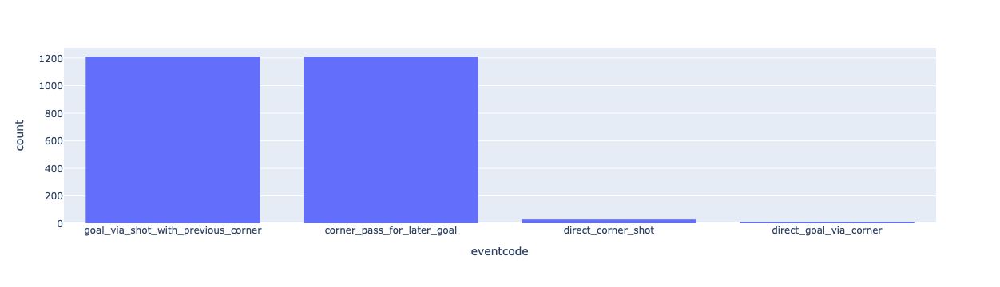

In [15]:
fig = px.histogram(df_corners, x='eventcode')
fig.show()

### Prepare the intermediate dataset for the evaluation

In [17]:
# get corner pass technique
df_corner_pass_for_later_goal = (df_corners
    .query("eventcode == 'corner_pass_for_later_goal'")
    .assign(corner_pass_technique=lambda df_: df_['pass'].apply(lambda x: x.get('technique', {}).get('name') if isinstance(x, dict) and 'technique' in x else np.nan))
    .assign(corner_pass_height=lambda df_: df_['pass'].apply(lambda x: x.get('height', {}).get('name') if isinstance(x, dict) and 'height' in x else np.nan))
    .assign(pass_length=lambda df_: df_['pass'].apply(lambda x: x.get('length', {}) if isinstance(x, dict) and 'length' in x else np.nan))
    .assign(pass_angle=lambda df_: df_['pass'].apply(lambda x: x.get('angle', {}) if isinstance(x, dict) and 'angle' in x else np.nan))  
    .assign(end_loc_x=lambda df_: df_['pass'].apply(lambda x: x.get('end_location', {})[0] if isinstance(x, dict) and 'end_location' in x else np.nan)) 
    .assign(end_loc_y=lambda df_: df_['pass'].apply(lambda x: x.get('end_location', {})[1] if isinstance(x, dict) and 'end_location' in x else np.nan)) 
    .dropna(subset=['corner_pass_technique', 'corner_pass_height', 'pass_length', 'pass_angle'])
    .rename(columns={
        "corner_pass_technique": "Corner-pass technique",
        "corner_pass_height": "Corner-pass height",
        "pass_length": "Pass length",
        "pass_angle": "Pass angle",
    })
    .assign(goal="Yes")
) 

print(f"Number of corner passes: {df_corner_pass_for_later_goal.shape}")
df_corner_pass_for_later_goal.head()

Number of corner passes: (946, 51)


,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,player_off,half_start,half_end,Corner-pass technique,Corner-pass height,Pass length,Pass angle,end_loc_x,end_loc_y,goal
1,2a4de53e-547b-4485-8972-2aa90a671716,2888,2,2024-09-10 00:39:34.964,84,34,"{'id': 30, 'name': 'Pass'}",180,"{'id': 216, 'name': 'Getafe'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,Inswinging,High Pass,32.339450,1.663696,117.0,32.3,Yes
5,1b1cf446-bd02-4f88-bd93-d0a2a7efadfb,2268,2,2024-09-10 00:15:42.664,60,42,"{'id': 30, 'name': 'Pass'}",120,"{'id': 217, 'name': 'Barcelona'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,Outswinging,High Pass,44.537174,-1.797259,110.0,36.6,Yes
7,53020c5a-28da-4292-b9c5-e0064303a5e3,180,1,2024-09-10 00:03:51.187,3,51,"{'id': 30, 'name': 'Pass'}",8,"{'id': 181, 'name': 'Schalke 04'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,Straight,High Pass,37.258020,1.831399,110.4,36.1,Yes
9,f9c435a5-21a5-49b2-86a9-47bb0db3e1a3,2243,2,2024-09-10 00:02:32.619,47,32,"{'id': 30, 'name': 'Pass'}",87,"{'id': 131, 'name': 'Paris Saint-Germain'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,Inswinging,High Pass,36.122154,1.681759,116.0,36.0,Yes
11,55340a86-9415-4a28-80d2-a5bfe99a31d6,3294,2,2024-09-10 00:42:47.357,87,47,"{'id': 30, 'name': 'Pass'}",170,"{'id': 222, 'name': 'Villarreal'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,Inswinging,High Pass,50.243904,1.646500,116.2,50.2,Yes


In [848]:
df_corners_wo_goal_intermediate = (df_corners_wo_goal
    .assign(corner_pass_technique=lambda df_: df_['pass'].apply(lambda x: x.get('technique', {}).get('name') if isinstance(x, dict) and 'technique' in x else np.nan))
    .assign(corner_pass_height=lambda df_: df_['pass'].apply(lambda x: x.get('height', {}).get('name') if isinstance(x, dict) and 'height' in x else np.nan))
    .assign(pass_length=lambda df_: df_['pass'].apply(lambda x: x.get('length', {}) if isinstance(x, dict) and 'length' in x else np.nan))
    .assign(pass_angle=lambda df_: df_['pass'].apply(lambda x: x.get('angle', {}) if isinstance(x, dict) and 'angle' in x else np.nan))
    .dropna(subset=['corner_pass_technique', 'corner_pass_height', 'pass_length', 'pass_angle'])
    .rename(columns={
        "corner_pass_technique": "Corner-pass technique",
        "corner_pass_height": "Corner-pass height",
        "pass_length": "Pass length",
        "pass_angle": "Pass angle",
    })
    .assign(goal="No")                             
)

df_corners_wo_goal_intermediate

,id,index,period,timestamp,minute,second,type,possession,possession_team,play_pattern,...,50_50,injury_stoppage,player_off,half_start,half_end,Corner-pass technique,Corner-pass height,Pass length,Pass angle,goal
0,4f711178-73da-4ce6-b073-2c5a23cb9ac7,230,1,2024-09-10 00:07:06.781,7,6,"{'id': 30, 'name': 'Pass'}",18,"{'id': 1683, 'name': 'Carpi'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,Inswinging,High Pass,36.289116,-1.717370,No
1,921173ba-b094-469a-bb04-8af4140c557b,630,1,2024-09-10 00:20:10.433,20,10,"{'id': 30, 'name': 'Pass'}",51,"{'id': 226, 'name': 'Hellas Verona'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,Outswinging,High Pass,34.707058,1.724103,No
2,ba402900-b4bc-47e2-abde-c5750ef839db,841,1,2024-09-10 00:27:37.817,27,37,"{'id': 30, 'name': 'Pass'}",61,"{'id': 226, 'name': 'Hellas Verona'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,Outswinging,High Pass,32.080680,1.676979,No
4,3017ff11-eb10-4f1c-8a8e-5bcad01b480f,1504,2,2024-09-10 00:00:58.653,45,58,"{'id': 30, 'name': 'Pass'}",117,"{'id': 1683, 'name': 'Carpi'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,Straight,High Pass,34.399563,1.678564,No
5,f03b5210-5dcf-4879-8a7d-70916921a7db,1895,2,2024-09-10 00:13:44.356,58,44,"{'id': 30, 'name': 'Pass'}",140,"{'id': 1683, 'name': 'Carpi'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,Inswinging,High Pass,40.951800,-1.735142,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32530,9a1001e9-ac66-4016-9266-033d8a54bac5,1980,2,2024-09-10 00:06:39.005,51,39,"{'id': 30, 'name': 'Pass'}",112,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,Inswinging,High Pass,36.656513,-1.710379,No
32531,18d5faf9-2b2c-443a-94fa-7de7e1c42b8b,1984,2,2024-09-10 00:07:07.810,52,7,"{'id': 30, 'name': 'Pass'}",113,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,Straight,High Pass,45.609756,1.704942,No
32532,0e970bec-0c5b-42bb-8c90-d84957e48cb3,2438,2,2024-09-10 00:20:03.927,65,3,"{'id': 30, 'name': 'Pass'}",132,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,Inswinging,High Pass,39.171036,1.688502,No
32534,32e7d492-1917-482c-aea4-1bc56c61825e,2835,2,2024-09-10 00:34:12.427,79,12,"{'id': 30, 'name': 'Pass'}",159,"{'id': 236, 'name': 'Lazio'}","{'id': 2, 'name': 'From Corner'}",...,NaN,NaN,NaN,NaN,NaN,Outswinging,High Pass,31.848705,-1.940224,No


### Trend 1: Direct shots from the corner (id=61) that hit the goal (id=97)

In [19]:
df_corner_direct_goal = (df_corners
    .groupby(["eventcode"]).count()[["id"]]
    .reset_index()
    .rename(columns={"eventcode": "Event", "id": "Count"})
    .replace(['direct_corner_shot', 'direct_goal_via_corner'], ['Direct corner shot', 'Direct corner shot with goal'])
    .query(f"Event == 'Direct corner shot' or Event == 'Direct corner shot with goal'")
)

df_corner_direct_goal

,Event,Count
1,Direct corner shot,28
2,Direct corner shot with goal,10


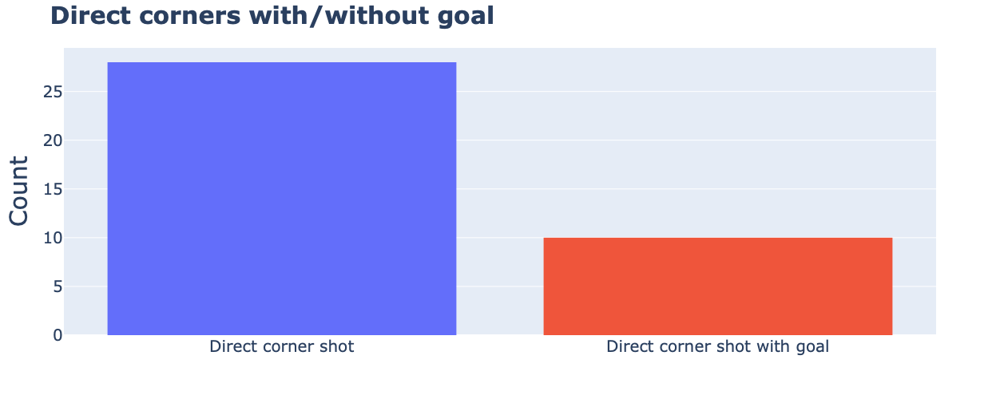

In [21]:
# plot only the direct corners
fig = px.histogram(df_corner_direct_goal, x="Event", y="Count", color="Event", height=500, color_discrete_sequence=px.colors.qualitative.Plotly)

# x-axis
fig.update_xaxes(
    title="", #"Shot that leads to a goal",
    title_font_size=30,
    tickfont=dict(size=20),   
    title_standoff=20,
)

# y-axis
fig.update_yaxes(
    title="Count",
    title_font_size=30,
    tickfont=dict(size=20),
    title_standoff=10
)

# legend
fig.update_layout(
    legend=dict(
    yanchor="top",
    y=0.99,
    font=dict(size=20))
)

fig.update_layout(
    showlegend=False,
    font={'size': 25},
    title={'text': '<b>Direct corners with/without goal</b>', 'font': {'size': 30}}
)

fig.show()

fig.write_html("./figures/Corner_shot_w-wo_goal.html", include_plotlyjs="cdn")

### Trend 2: Finding corner passes (id=61) that hit the goal after a shot (id=97) with the corresponding techniques and height of the pass:
- Inswinging (id=104)
- Outswinging (id=105)
- Straight (id=107)
- Through Ball (id=108)

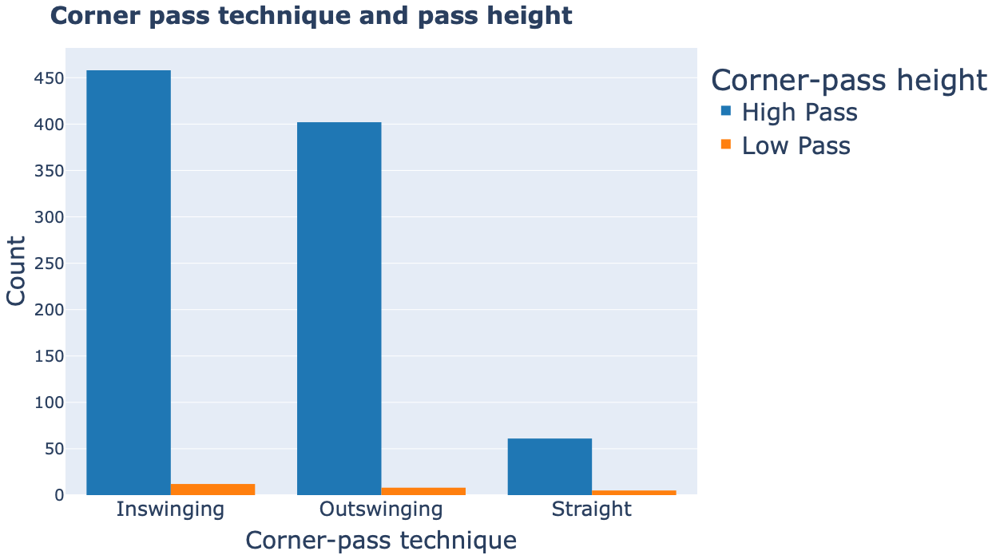

In [24]:
# plot the corner pass technique with according pass height
fig = px.histogram(df_corner_pass_for_later_goal, x="Corner-pass technique", color="Corner-pass height",
            height=700, width=1200, color_discrete_sequence=px.colors.qualitative.D3, barmode="group")

# y-axis
fig.update_yaxes(
    title="Count",
    title_font_size=30,
    tickfont=dict(size=20),
    title_standoff=10
)

# legend
fig.update_layout(
    legend=dict(
    yanchor="top",
    y=0.99,
    font=dict(size=30))
)

fig.update_layout(
    font={'size': 25},
    title={'text': '<b>Corner pass technique and pass height</b>', 'font': {'size': 30}}
)

fig.show()

fig.write_html("./figures/Corner_pass_technique_height.html", include_plotlyjs="cdn")

### Trend 3: Finding corner passes (id=61) that hit the goal after a shot (id=97) with their pass length and angle:
- length in yards of the pass, from its origin to its destination
- The angle of the pass in radians:
    - with 0 pointing straight ahead
    - positive values between 0 and π indicating an angle clockwise
    - and negative values between 0 and -π representing an angle anti-clockwise
- check also for significant differences with regard to the pass length for corner pass 'Inswinging' technique wheater this corner technique results in a goal or not

In [830]:
df_goal = df_corner_pass_for_later_goal[['id', 'Corner-pass technique', 'Corner-pass height', 'Pass length', 'Pass angle', 'goal']]
df_goal.head()

,id,Corner-pass technique,Corner-pass height,Pass length,Pass angle,goal
1,2a4de53e-547b-4485-8972-2aa90a671716,Inswinging,High Pass,32.339450,1.663696,Yes
5,1b1cf446-bd02-4f88-bd93-d0a2a7efadfb,Outswinging,High Pass,44.537174,-1.797259,Yes
7,53020c5a-28da-4292-b9c5-e0064303a5e3,Straight,High Pass,37.258020,1.831399,Yes
9,f9c435a5-21a5-49b2-86a9-47bb0db3e1a3,Inswinging,High Pass,36.122154,1.681759,Yes
11,55340a86-9415-4a28-80d2-a5bfe99a31d6,Inswinging,High Pass,50.243904,1.646500,Yes


In [856]:
df_nogoal = df_corners_wo_goal_intermediate[['id', 'Corner-pass technique', 'Corner-pass height', 'Pass length', 'Pass angle', 'goal']]
df_nogoal.head()

,id,Corner-pass technique,Corner-pass height,Pass length,Pass angle,goal
0,4f711178-73da-4ce6-b073-2c5a23cb9ac7,Inswinging,High Pass,36.289116,-1.717370,No
1,921173ba-b094-469a-bb04-8af4140c557b,Outswinging,High Pass,34.707058,1.724103,No
2,ba402900-b4bc-47e2-abde-c5750ef839db,Outswinging,High Pass,32.080680,1.676979,No
4,3017ff11-eb10-4f1c-8a8e-5bcad01b480f,Straight,High Pass,34.399563,1.678564,No
5,f03b5210-5dcf-4879-8a7d-70916921a7db,Inswinging,High Pass,40.951800,-1.735142,No


In [870]:
df_w_wo_goal = pd.concat([df_goal, df_nogoal])

#df_w_wo_goal.to_json("./intermediate_datasets/corners_w_wo_goal_statistics.json", orient='records')

In [872]:
df_w_wo_goal = pd.read_json("./intermediate_datasets/corners_w_wo_goal_statistics.json")

print(f"DataFrame size with goals: {df_goal.shape} without goals: {df_nogoal.shape} and in total: {df_w_wo_goal.shape}")
df_w_wo_goal.head()

DataFrame size with goals: (946, 6) without goals: (24945, 6) and in total: (25891, 6)


,id,Corner-pass technique,Corner-pass height,Pass length,Pass angle,goal
0,2a4de53e-547b-4485-8972-2aa90a671716,Inswinging,High Pass,32.339450,1.663696,Yes
1,1b1cf446-bd02-4f88-bd93-d0a2a7efadfb,Outswinging,High Pass,44.537174,-1.797259,Yes
2,53020c5a-28da-4292-b9c5-e0064303a5e3,Straight,High Pass,37.258020,1.831399,Yes
3,f9c435a5-21a5-49b2-86a9-47bb0db3e1a3,Inswinging,High Pass,36.122154,1.681759,Yes
4,55340a86-9415-4a28-80d2-a5bfe99a31d6,Inswinging,High Pass,50.243904,1.646500,Yes


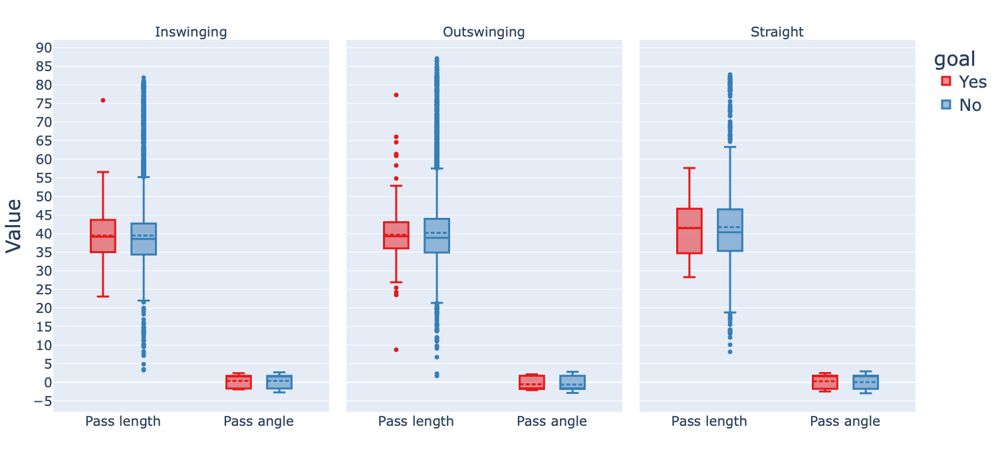

In [918]:
fig = px.box(df_w_wo_goal, y=["Pass length", "Pass angle"], color="goal", facet_col="Corner-pass technique",
             color_discrete_sequence=px.colors.qualitative.Set1, points="outliers", width=1200, height=700)

# x-axis
fig.update_xaxes(
    title="",
    tickfont=dict(size=20),
    zerolinewidth=2, 
    zerolinecolor='black'   
)

# y-axis
fig.update_yaxes(
    title="Value",
    title_font_size=30,
    tickfont=dict(size=20),
    dtick=5    
)

# legend
fig.update_layout(
    boxgap=0.4,
    boxgroupgap=0.4,
    legend=dict(
        yanchor="top",
        font=dict(size=25),
    )
)

# lines width and marker size
fig.update_traces(
    line=dict(width=3.),
    marker={'size': 7}
)

# add mean
fig.for_each_trace(lambda trace: trace.update(boxmean=True))     

# facet label
fig.for_each_annotation(lambda a: a.update(font=dict(size=20), text=a.text.split("=")[-1]))

# remove second and third yaxis title
fig.update_layout(yaxis2=dict(title=""), yaxis3=dict(title=""))

fig.show()

fig.write_html("./figures/Corner_pass_w_wo_goal_box.html", include_plotlyjs="cdn")

In [946]:
# test for significant differences with regard to the pass length for corner pass 'Inswinging' technique wheater this corner technique results in a goal or not
arr_no_goal = df_nogoal[df_nogoal['Corner-pass technique']=='Inswinging']['Pass length'].to_numpy()

print(len(arr_no_goal), np.var(arr_no_goal))
arr_no_goal

12239 67.14898590683532


array([36.289116, 40.9518  , 32.773922, ..., 36.656513, 39.171036,
       40.00925 ])

In [948]:
arr_goal = df_goal[df_goal['Corner-pass technique']=='Inswinging']['Pass length'].to_numpy()

print(len(arr_goal), np.var(arr_goal))
arr_goal[:10]

470 35.72559864806411


array([32.33945 , 36.122154, 50.243904, 47.420353, 32.125534, 33.306156,
       39.870415, 35.20568 , 37.981705, 43.304157])

In [958]:
# Get the p-value
statistic, pvalue = stats.ttest_ind(
    arr_no_goal,
    arr_goal,
    equal_var=False,
)#[1]

print(statistic, pvalue)

0.07434242135502345 0.9407655102236525


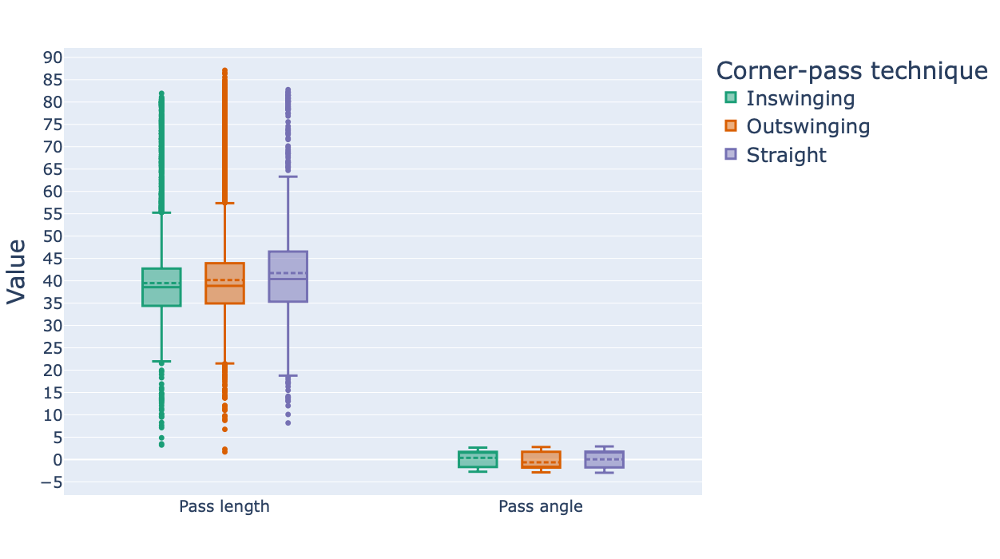

In [882]:
fig = px.box(df_w_wo_goal, y=["Pass length", "Pass angle"], color="Corner-pass technique", 
             color_discrete_sequence=px.colors.qualitative.Dark2, points="outliers", width=1200, height=700)

# x-axis
fig.update_xaxes(
    title="",
    tickfont=dict(size=20),
    zerolinewidth=2, 
    zerolinecolor='black'   
)

# y-axis
fig.update_yaxes(
    title="Value",
    title_font_size=30,
    tickfont=dict(size=20),
    dtick=5    
)

# legend
fig.update_layout(
    boxgap=0.4,
    boxgroupgap=0.4,
    legend=dict(
        yanchor="top",
        font=dict(size=25),
    )
)

# lines width and marker size
fig.update_traces(
    line=dict(width=3.),
    marker={'size': 7}
)

# add mean
fig.for_each_trace(lambda trace: trace.update(boxmean=True))        

fig.show()

fig.write_html("./figures/Corner_pass_length_and_angle_box.html", include_plotlyjs="cdn")

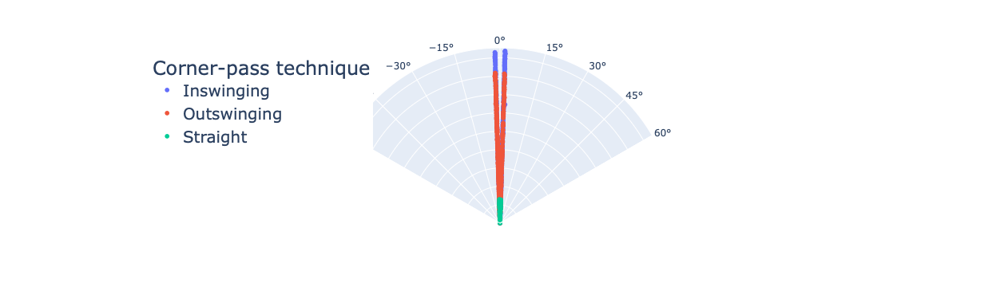

In [647]:
fig = px.scatter_polar(df_corner_pass_for_later_goal, theta="Pass angle", color="Corner-pass technique", range_theta=[30,150])

fig.update_layout(
    polar = dict(radialaxis = dict(showticklabels=False, ticks=''))
)

# legend
fig.update_layout(
    legend=dict(
    yanchor="top",
    y=0.99,
    x=0.1,
    font=dict(size=20))
)

fig.show()

fig.write_html("./figures/Corner_pass_angle_polar.html", include_plotlyjs="cdn")

### Trend 4: Finding corner passes (id=61) that hit the goal after a shot (id=97) with their according end location of the ball [x, y]

In [134]:
# determine the rectangle for the individual corner pass technique
x0_inswing = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Inswinging']['end_loc_x'].min()
x1_inswing = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Inswinging']['end_loc_x'].max()
y0_inswing = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Inswinging']['end_loc_y'].min()
y1_inswing = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Inswinging']['end_loc_y'].max()

x0_outswing = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Outswinging']['end_loc_x'].min()
x1_outswing = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Outswinging']['end_loc_x'].max()
y0_outswing = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Outswinging']['end_loc_y'].min()
y1_outswing = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Outswinging']['end_loc_y'].max()

x0_straight = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Straight']['end_loc_x'].min()
x1_straight = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Straight']['end_loc_x'].max()
y0_straight = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Straight']['end_loc_y'].min()
y1_straight = df_corner_pass_for_later_goal[df_corner_pass_for_later_goal['Corner-pass technique']=='Straight']['end_loc_y'].max()

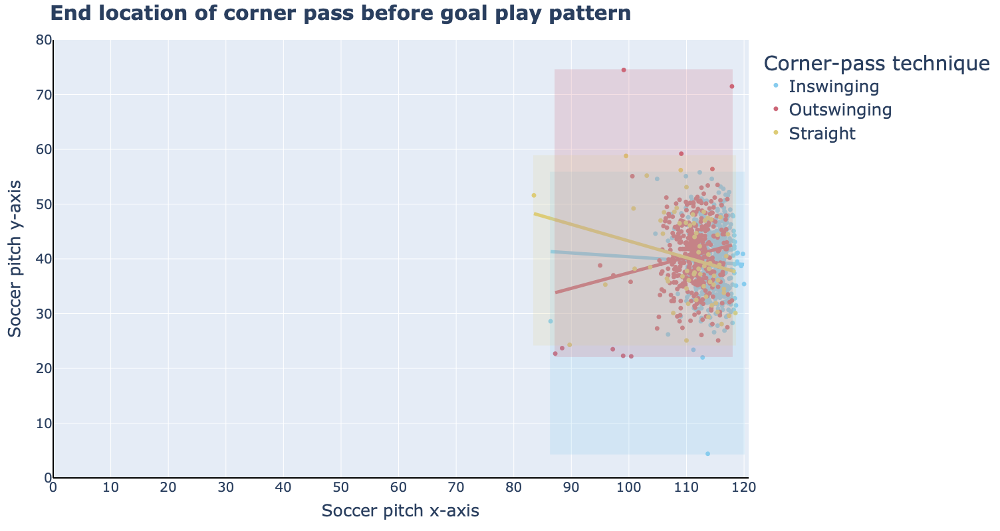

In [154]:
fig = px.scatter(df_corner_pass_for_later_goal, x="end_loc_x", y="end_loc_y", width=1300, height=800, 
                 color="Corner-pass technique", color_discrete_sequence=px.colors.qualitative.Safe, trendline="ols") # ols, lowess

# x-axis
fig.update_xaxes(
    title="Soccer pitch x-axis",
    title_font_size=25,
    tickfont=dict(size=20),
    dtick=10,
    range=[0, 120.8],
    zerolinewidth=2, 
    zerolinecolor='black',
)

# y-axis
fig.update_yaxes(
    title="Soccer pitch y-axis",
    title_font_size=25,
    tickfont=dict(size=20),
    range=[0, 80],
    zerolinewidth=2, 
    zerolinecolor='black',
)

# lines width and marker size
fig.update_traces(marker={'size': 7})

# legend
fig.update_layout(
    legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    font=dict(size=25),
))

# Update the trendline thickness (modify the first trace, which is the trendline)
fig.update_traces(line=dict(width=5), selector=dict(type='scatter', mode='lines'))

fig.update_layout(
    font={'size': 25},
    title={'text': '<b>End location of corner pass before goal play pattern</b>', 'font': {'size': 30}}
)

# Add rectangle for Inswinging corner
fig.add_shape(type="rect",
    xref="x", yref="y",
    x0=x0_inswing, y0=y0_inswing,
    x1=x1_inswing, y1=y1_inswing,
    opacity=0.2,
    fillcolor=px.colors.qualitative.Safe[0],
    line_color=px.colors.qualitative.Safe[0],
)

# Add rectangle for Outswinging corner
fig.add_shape(type="rect",
    xref="x", yref="y",
    x0=x0_outswing, y0=y0_outswing,
    x1=x1_outswing, y1=y1_outswing,
    opacity=0.2,
    fillcolor=px.colors.qualitative.Safe[1],
    line_color=px.colors.qualitative.Safe[1],
)

# Add rectangle for Straigt corner
fig.add_shape(type="rect",
    xref="x", yref="y",
    x0=x0_straight, y0=y0_straight,
    x1=x1_straight, y1=y1_straight,
    opacity=0.15,
    fillcolor=px.colors.qualitative.Safe[2],
    line_color=px.colors.qualitative.Safe[2],
)

fig.show()

fig.write_html("./figures/Corner_pass_end_location.html", include_plotlyjs="cdn")

## b. Use the 360 data for the few matches where they are available, to see if you can find effective defensive set-ups.

In [526]:
files_freese_frames = glob("./open-data-master/data/three-sixty/*")

print("Total number of files/360 sets:", len(files_freese_frames))
files[:10]

Total number of files/360 sets: 295


['./open-data-master/data/three-sixty/3902240.json',
 './open-data-master/data/three-sixty/3938644.json',
 './open-data-master/data/three-sixty/3788742.json',
 './open-data-master/data/three-sixty/3893798.json',
 './open-data-master/data/three-sixty/3869354.json',
 './open-data-master/data/three-sixty/3893809.json',
 './open-data-master/data/three-sixty/3788754.json',
 './open-data-master/data/three-sixty/3893825.json',
 './open-data-master/data/three-sixty/3895158.json',
 './open-data-master/data/three-sixty/3857292.json']

In [528]:
print("Read file:", files_freese_frames[40])
df_three_test = pd.read_json(files_freese_frames[40]) 

print(df_three_test.columns)

print(f"Size of dataframe: {df_three_test.shape}") # and datatypes:\n{df_event_test.dtypes}") 
df_three_test.head()

Read file: ./open-data-master/data/three-sixty/3857266.json
Index(['event_uuid', 'visible_area', 'freeze_frame'], dtype='object')
Size of dataframe: (3290, 3)


,event_uuid,visible_area,freeze_frame
0,5a1bb2e7-fde1-4e3d-a331-2f6d4698e36e,"[12.307859690377, 80.0, 41.9817181390851, 0.0,...","[{'teammate': True, 'actor': False, 'keeper': ..."
1,8030d926-c5fb-4abf-af7c-216eb4df13d9,"[11.862200102872, 80.0, 41.7940694041057, 0.0,...","[{'teammate': True, 'actor': False, 'keeper': ..."
2,14f4c9f4-33cd-4ca1-97a7-8d4d0d209609,"[11.862200102872, 80.0, 41.7940694041057, 0.0,...","[{'teammate': True, 'actor': False, 'keeper': ..."
3,c92c6e1c-c6a7-4018-8321-093241aa6596,"[23.6166850551218, 80.0, 47.4167371969312, 0.0...","[{'teammate': True, 'actor': False, 'keeper': ..."
4,594b9080-ff52-4a3c-ad4b-69da13403cbd,"[34.7462953710152, 80.0, 49.9796978695372, 7.0...","[{'teammate': True, 'actor': False, 'keeper': ..."


In [763]:
df_three_test_single = df_three_test.loc[42:43]
df_three_test_single

,event_uuid,visible_area,freeze_frame
42,2439c812-71f9-4fc1-864b-61fe7892add7,"[0.0, 80.0, 0.0, 61.6619136535695, 30.32469024...","[{'teammate': True, 'actor': True, 'keeper': T..."
43,aebf05f3-75d3-4191-9a8c-08f07d9eb4b5,"[22.4985076696792, 80.0, 42.3872165649152, 14....","[{'teammate': True, 'actor': False, 'keeper': ..."


### Preparation of multiple functions for extracting the visible area and the individual positions of the players

In [663]:
def get_visible_area_coordinates(df_):  
    return (pd.DataFrame()
        .assign(visible_area_x=df_['visible_area'].apply(lambda x: x[::2]))
        .assign(visible_area_y=df_['visible_area'].apply(lambda x: x[1::2]))
        .assign(event_uuid=df_['event_uuid'].apply(lambda x: x))
        .set_index('event_uuid').apply(pd.Series.explode).reset_index()        
    )

In [745]:
get_visible_area_coordinates(df_three_test_single)

,event_uuid,visible_area_x,visible_area_y
0,2439c812-71f9-4fc1-864b-61fe7892add7,0.0,80.0
1,2439c812-71f9-4fc1-864b-61fe7892add7,0.0,61.661914
2,2439c812-71f9-4fc1-864b-61fe7892add7,30.32469,9.006613
3,2439c812-71f9-4fc1-864b-61fe7892add7,61.342665,18.390359
4,2439c812-71f9-4fc1-864b-61fe7892add7,61.077709,80.0
5,2439c812-71f9-4fc1-864b-61fe7892add7,0.0,80.0
6,aebf05f3-75d3-4191-9a8c-08f07d9eb4b5,22.498508,80.0
7,aebf05f3-75d3-4191-9a8c-08f07d9eb4b5,42.387217,14.334681
8,aebf05f3-75d3-4191-9a8c-08f07d9eb4b5,73.192729,14.556697
9,aebf05f3-75d3-4191-9a8c-08f07d9eb4b5,90.656039,80.0


In [749]:
def get_freeze_frame_info(df_):
    return (pd.DataFrame()
        .assign(teammate=df_['freeze_frame'].apply(lambda x: [player['teammate'] for player in x]))
        .assign(actor=df_['freeze_frame'].apply(lambda x: [player['actor'] for player in x]))         
        .assign(keeper=df_['freeze_frame'].apply(lambda x: [player['keeper'] for player in x]))
        .assign(location_x=df_['freeze_frame'].apply(lambda x: [player['location'][0] for player in x])) 
        .assign(location_y=df_['freeze_frame'].apply(lambda x: [player['location'][1] for player in x])) 
        .assign(event_uuid=df_['event_uuid'].apply(lambda x: x))
        .set_index('event_uuid').apply(pd.Series.explode).reset_index()
        .assign(teammate_category=lambda x: ['teammate' if val == True else 'opponent' for val in x['teammate']])
        .assign(actor_category=lambda x: ['actor' if val == True else 'non-actor' for val in x['actor']])
        .assign(keeper_category=lambda x: ['keeper' if val == True else 'player' for val in x['keeper']])
    )

In [743]:
get_freeze_frame_info(df_three_test_single)

,event_uuid,teammate,actor,keeper,location_x,location_y,teammate_category,actor_category,keeper_category
0,2439c812-71f9-4fc1-864b-61fe7892add7,True,True,True,23.5,52.0,teammate,actor,keeper
1,2439c812-71f9-4fc1-864b-61fe7892add7,True,False,False,27.298834,65.009051,teammate,non-actor,player
2,2439c812-71f9-4fc1-864b-61fe7892add7,True,False,False,30.240036,42.367776,teammate,non-actor,player
3,2439c812-71f9-4fc1-864b-61fe7892add7,True,False,False,34.993533,19.526347,teammate,non-actor,player
4,2439c812-71f9-4fc1-864b-61fe7892add7,False,False,False,36.08542,44.067301,opponent,non-actor,player
5,2439c812-71f9-4fc1-864b-61fe7892add7,False,False,False,39.273706,61.974411,opponent,non-actor,player
6,2439c812-71f9-4fc1-864b-61fe7892add7,True,False,False,46.734633,42.927346,teammate,non-actor,player
7,2439c812-71f9-4fc1-864b-61fe7892add7,False,False,False,52.000885,33.647706,opponent,non-actor,player
8,2439c812-71f9-4fc1-864b-61fe7892add7,False,False,False,53.870975,21.787159,opponent,non-actor,player
9,2439c812-71f9-4fc1-864b-61fe7892add7,True,False,False,57.090807,83.358643,teammate,non-actor,player


### Visualize for a single freeze frame

In [775]:
df_three_test_single_visible_area = get_visible_area_coordinates(df_three_test_single)
df_three_test_single_visible_area = df_three_test_single_visible_area[df_three_test_single_visible_area["event_uuid"]=="2439c812-71f9-4fc1-864b-61fe7892add7"]
df_three_test_single_visible_area

,event_uuid,visible_area_x,visible_area_y
0,2439c812-71f9-4fc1-864b-61fe7892add7,0.0,80.0
1,2439c812-71f9-4fc1-864b-61fe7892add7,0.0,61.661914
2,2439c812-71f9-4fc1-864b-61fe7892add7,30.32469,9.006613
3,2439c812-71f9-4fc1-864b-61fe7892add7,61.342665,18.390359
4,2439c812-71f9-4fc1-864b-61fe7892add7,61.077709,80.0
5,2439c812-71f9-4fc1-864b-61fe7892add7,0.0,80.0


In [783]:
df_three_test_single_freeze_frame = get_freeze_frame_info(df_three_test_single)
df_three_test_single_freeze_frame = df_three_test_single_freeze_frame[df_three_test_single_freeze_frame["event_uuid"]=="2439c812-71f9-4fc1-864b-61fe7892add7"]
df_three_test_single_freeze_frame

,event_uuid,teammate,actor,keeper,location_x,location_y,teammate_category,actor_category,keeper_category
0,2439c812-71f9-4fc1-864b-61fe7892add7,True,True,True,23.5,52.0,teammate,actor,keeper
1,2439c812-71f9-4fc1-864b-61fe7892add7,True,False,False,27.298834,65.009051,teammate,non-actor,player
2,2439c812-71f9-4fc1-864b-61fe7892add7,True,False,False,30.240036,42.367776,teammate,non-actor,player
3,2439c812-71f9-4fc1-864b-61fe7892add7,True,False,False,34.993533,19.526347,teammate,non-actor,player
4,2439c812-71f9-4fc1-864b-61fe7892add7,False,False,False,36.08542,44.067301,opponent,non-actor,player
5,2439c812-71f9-4fc1-864b-61fe7892add7,False,False,False,39.273706,61.974411,opponent,non-actor,player
6,2439c812-71f9-4fc1-864b-61fe7892add7,True,False,False,46.734633,42.927346,teammate,non-actor,player
7,2439c812-71f9-4fc1-864b-61fe7892add7,False,False,False,52.000885,33.647706,opponent,non-actor,player
8,2439c812-71f9-4fc1-864b-61fe7892add7,False,False,False,53.870975,21.787159,opponent,non-actor,player
9,2439c812-71f9-4fc1-864b-61fe7892add7,True,False,False,57.090807,83.358643,teammate,non-actor,player


In [785]:
polygon_x = df_three_test_single_visible_area['visible_area_x'].to_numpy()
polygon_y = df_three_test_single_visible_area['visible_area_y'].to_numpy()

print(polygon_x, polygon_y)

[0.0 0.0 30.3246902472383 61.3426654740077 61.0777090348261 0.0] [80.0 61.6619136535695 9.00661251365509 18.3903590167589 80.0 80.0]


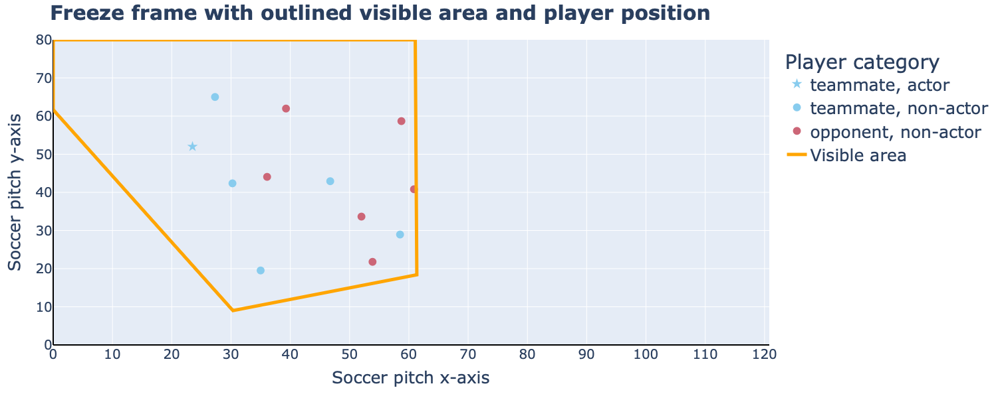

In [796]:
fig = px.scatter(df_three_test_single_freeze_frame, x="location_x", y="location_y", color="teammate_category", symbol="actor_category", 
                 symbol_sequence=['star', 'circle'], color_discrete_sequence=px.colors.qualitative.Safe, width=1200, height=600)#, trendline="ols") # ols, lowess

# x-axis
fig.update_xaxes(
    title="Soccer pitch x-axis",
    title_font_size=25,
    tickfont=dict(size=20),
    dtick=10,
    range=[0, 120.8],
    zerolinewidth=2, 
    zerolinecolor='black',
)

# y-axis
fig.update_yaxes(
    title="Soccer pitch y-axis",
    title_font_size=25,
    tickfont=dict(size=20),
    range=[0, 80],
    zerolinewidth=2, 
    zerolinecolor='black',
)

# Add the polygon for the visible area
fig.add_trace(go.Scatter(
    x=polygon_x, 
    y=polygon_y, 
    #fill='toself',                         
    mode='lines', 
    line=dict(color='orange', width=5), 
    fillcolor='lightblue', 
    name='Visible area'),
)

# lines width and marker size
fig.update_traces(marker={'size': 12})

# legend
fig.update_layout(   
    legend=dict(
         title="Player category",
        yanchor="top",
        y=0.99,
        xanchor="left",
        font=dict(size=25),
))

# Update the polygon selector of the visible area (modify the first trace, which is the polygon)
fig.update_traces(selector=dict(type='scatter', mode='lines'))

fig.update_layout(
    font={'size': 25},
    title={'text': '<b>Freeze frame with outlined visible area and player position</b>', 'font': {'size': 30}}
)

fig.show()

fig.write_html("./figures/Freeze_frame_game_sitation_single.html", include_plotlyjs="cdn")

### Load all visible areas and freeze frames and link to the events to find out whether this single freeze frame was under the play pattern of a corner and whether it led to a goal or not

In [812]:
def collect_visible_areas_and_freeze_frames(files_freese_frames):

    df_visible_areas = pd.DataFrame()
    df_freeze_frames = pd.DataFrame()
    
    # load all dataframes by iterating over the files
    for i, file in enumerate(files_freese_frames):  

        # get the filename which corresponds to the match-id (not mentioned in the documentation)
        filename = Path(file).stem

        ### load the current file
        try:
            df_tmp = pd.read_json(file)  
        except:
            print(f"ERROR [{i} / {len(files)}]-Index with match-id: {filename}")
        
        # get all visible areas
        df_visible_area_tmp = get_visible_area_coordinates(df_tmp)

        # get all freeze frames
        df_freeze_frame_tmp = get_freeze_frame_info(df_tmp)
        
        # collect all visible areas together
        df_visible_areas = pd.concat([df_visible_areas, df_visible_area_tmp])

        # collect all freeze frames together
        df_freeze_frames = pd.concat([df_freeze_frames, df_freeze_frame_tmp])
        
        if i % 50 == 0:
            print(f"[{i} / {len(files)}]-Index with match-id: {filename} with Original dataframe size: {df_tmp.shape}")
            print(f"\tvisible areas: {df_visible_areas.shape} ; freeze frames: {df_freeze_frames.shape}")
    
        #if i == 5:
        #    break
    
    return df_visible_areas, df_freeze_frames

In [814]:
%%time

df_visible_areas, df_freeze_frames = collect_visible_areas_and_freeze_frames(files_freese_frames)

df_visible_areas

[0 / 295]-Index with match-id: 3902240 with Original dataframe size: (3811, 3)
	visible areas: (20802, 3) ; freeze frames: (53990, 9)
ERROR [14 / 295]-Index with match-id: 3835338
[50 / 295]-Index with match-id: 3895250 with Original dataframe size: (3410, 3)
	visible areas: (907980, 3) ; freeze frames: (2403578, 9)
ERROR [73 / 295]-Index with match-id: 3835342
[100 / 295]-Index with match-id: 3902968 with Original dataframe size: (3373, 3)
	visible areas: (1841497, 3) ; freeze frames: (4857383, 9)
[150 / 295]-Index with match-id: 3788773 with Original dataframe size: (3248, 3)
	visible areas: (2761443, 3) ; freeze frames: (7327130, 9)
ERROR [198 / 295]-Index with match-id: 3845506
[200 / 295]-Index with match-id: 3857254 with Original dataframe size: (3157, 3)
	visible areas: (3692270, 3) ; freeze frames: (9852184, 9)
[250 / 295]-Index with match-id: 3930169 with Original dataframe size: (2815, 3)
	visible areas: (4594949, 3) ; freeze frames: (12208682, 9)
CPU times: user 2min 57s, sy

,event_uuid,visible_area_x,visible_area_y
0,75d6cc25-b03b-44e0-9c50-99a7e3c47315,29.574168,80.0
1,75d6cc25-b03b-44e0-9c50-99a7e3c47315,47.799207,0.0
2,75d6cc25-b03b-44e0-9c50-99a7e3c47315,74.417607,0.0
3,75d6cc25-b03b-44e0-9c50-99a7e3c47315,94.482156,80.0
4,75d6cc25-b03b-44e0-9c50-99a7e3c47315,29.574168,80.0
...,...,...,...
25603,29761d25-06f1-45c1-b72e-a01c14633e84,15.981348,0.0
25604,29761d25-06f1-45c1-b72e-a01c14633e84,17.39688,0.0
25605,29761d25-06f1-45c1-b72e-a01c14633e84,41.230627,16.308263
25606,29761d25-06f1-45c1-b72e-a01c14633e84,17.902746,80.0


### Merge this 360-dataset togehter with corner with/without goal events

In [832]:
df_visible_areas.head()

,event_uuid,visible_area_x,visible_area_y
0,75d6cc25-b03b-44e0-9c50-99a7e3c47315,29.574168,80.0
1,75d6cc25-b03b-44e0-9c50-99a7e3c47315,47.799207,0.0
2,75d6cc25-b03b-44e0-9c50-99a7e3c47315,74.417607,0.0
3,75d6cc25-b03b-44e0-9c50-99a7e3c47315,94.482156,80.0
4,75d6cc25-b03b-44e0-9c50-99a7e3c47315,29.574168,80.0


In [844]:
df_freeze_frames.head()

,event_uuid,teammate,actor,keeper,location_x,location_y,teammate_category,actor_category,keeper_category
0,75d6cc25-b03b-44e0-9c50-99a7e3c47315,True,False,False,39.386794,38.273757,teammate,non-actor,player
1,75d6cc25-b03b-44e0-9c50-99a7e3c47315,True,False,False,41.432154,54.068911,teammate,non-actor,player
2,75d6cc25-b03b-44e0-9c50-99a7e3c47315,True,False,False,53.529236,31.590172,teammate,non-actor,player
3,75d6cc25-b03b-44e0-9c50-99a7e3c47315,True,False,False,57.276517,20.489104,teammate,non-actor,player
4,75d6cc25-b03b-44e0-9c50-99a7e3c47315,True,False,False,59.746816,50.07629,teammate,non-actor,player


In [1042]:
df_shot_goal_nogoals_edited = pd.read_csv("./intermediate_datasets/shots_after_corner_w_wo_goal_intermediate.csv", index_col=0)

print(f"DataFrame size with and without goals: {df_shot_goal_nogoals_edited.shape}")
df_shot_goal_nogoals_edited.head()

DataFrame size with and without goals: (13924, 2)


,id,goal
1517,938981c0-ec27-432f-ba67-4a5264750294,No
1896,a26bd1d8-8746-4de6-9972-226dbf037123,No
2688,96e67146-48f7-47c4-b956-c1a18bf4e2a1,No
2906,457f342e-94d9-414a-a12b-676b3bdc3793,No
2939,4f811f97-b991-4760-8be4-20e211d91f9a,No


In [1466]:
df_freeze_frame_event = (df_freeze_frames
    .merge(df_shot_goal_nogoals_edited, how="left", left_on="event_uuid", right_on="id")
    .dropna(subset=["goal"])
    .drop(columns=["id"])
    .assign(marker_size=lambda df_: df_['actor'].apply(lambda x: 0.4 if x == True else 0.07))           
)

df_freeze_frame_event

,event_uuid,teammate,actor,keeper,location_x,location_y,teammate_category,actor_category,keeper_category,goal,marker_size
6815,ca18ba8a-13ce-4287-aa81-0b02a0e2e4df,False,False,False,95.251147,43.113602,opponent,non-actor,player,No,0.07
6816,ca18ba8a-13ce-4287-aa81-0b02a0e2e4df,False,False,False,98.217912,28.00216,opponent,non-actor,player,No,0.07
6817,ca18ba8a-13ce-4287-aa81-0b02a0e2e4df,True,False,False,101.821481,38.905794,teammate,non-actor,player,No,0.07
6818,ca18ba8a-13ce-4287-aa81-0b02a0e2e4df,False,False,False,106.777983,36.508244,opponent,non-actor,player,No,0.07
6819,ca18ba8a-13ce-4287-aa81-0b02a0e2e4df,False,False,False,107.244791,41.116926,opponent,non-actor,player,No,0.07
...,...,...,...,...,...,...,...,...,...,...,...
14402525,8d13e333-4930-4d4c-a5f7-a998f8c7fc73,False,False,False,116.283493,40.831504,opponent,non-actor,player,No,0.07
14402526,8d13e333-4930-4d4c-a5f7-a998f8c7fc73,False,False,False,116.465836,31.71431,opponent,non-actor,player,No,0.07
14402527,8d13e333-4930-4d4c-a5f7-a998f8c7fc73,False,False,False,117.268123,34.04374,opponent,non-actor,player,No,0.07
14402528,8d13e333-4930-4d4c-a5f7-a998f8c7fc73,False,False,True,118.086067,39.303187,opponent,non-actor,keeper,No,0.07


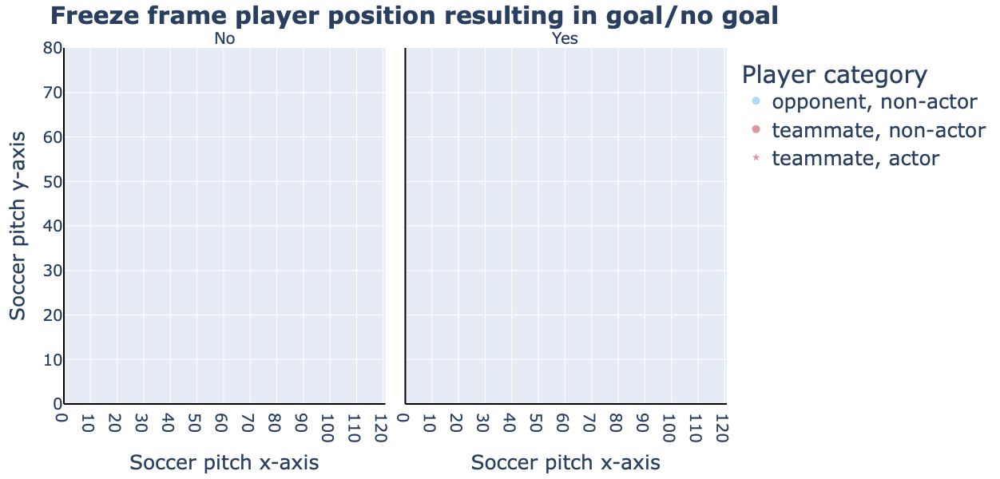

In [1467]:
fig = px.scatter(df_freeze_frame_event, x="location_x", y="location_y", color="teammate_category", symbol="actor_category", 
                 facet_col="goal", facet_col_wrap=4, facet_col_spacing=0.03, symbol_sequence=['circle', 'star'], size="marker_size",
                 color_discrete_sequence=px.colors.qualitative.Safe, width=1600, height=600)#, trendline="ols") # ols, lowess

# x-axis
fig.update_xaxes(
    title="Soccer pitch x-axis",
    title_font_size=25,
    tickfont=dict(size=20),
    dtick=10,
    range=[0, 120.8],
    zerolinewidth=2, 
    zerolinecolor='black',
)

# y-axis
fig.update_yaxes(
    title="Soccer pitch y-axis",
    title_font_size=25,
    tickfont=dict(size=20),
    range=[0, 80],
    zerolinewidth=2, 
    zerolinecolor='black',
)

# lines width and marker size
#fig.update_traces(marker={'size': 5})

# legend
fig.update_layout(   
    legend=dict(
         title="Player category",
        yanchor="top",
        y=0.99,
        xanchor="left",
        font=dict(size=25),
))

# Update the polygon selector of the visible area (modify the first trace, which is the polygon)
fig.update_traces(selector=dict(type='scatter', mode='lines'))

# facet label
fig.for_each_annotation(lambda a: a.update(font=dict(size=20), text=a.text.split("=")[-1]))

# remove second yaxis title
fig.update_layout(yaxis2=dict(title=""))

fig.update_layout(
    font={'size': 25},
    title={'text': '<b>Freeze frame player position resulting in goal/no goal</b>', 'font': {'size': 30}}
)

fig.show()

fig.write_html("./figures/Freeze_frame_game_sitation_goal_vs_nogoal.html", include_plotlyjs="cdn")

### Determine the area in which the players of the attacking team and the defending team are located

In [1525]:
from scipy.spatial import ConvexHull

In [1527]:
points_teammate_goal = df_freeze_frame_event.query("teammate_category == 'teammate' and goal == 'Yes' and actor_category == 'actor'")[["location_x", "location_y"]].to_numpy()
points_teammate_nogoal = df_freeze_frame_event.query("teammate_category == 'teammate' and goal == 'No' and actor_category == 'actor'")[["location_x", "location_y"]].to_numpy()

points_opponent_goal = df_freeze_frame_event.query("teammate_category == 'opponent' and goal == 'Yes'")[["location_x", "location_y"]].to_numpy()
points_opponent_nogoal = df_freeze_frame_event.query("teammate_category == 'opponent' and goal == 'No'")[["location_x", "location_y"]].to_numpy()

print(points_teammate_goal.shape, points_teammate_nogoal.shape)
print(points_opponent_goal.shape, points_opponent_nogoal.shape)

(109, 2) (1190, 2)
(1096, 2) (12267, 2)


In [1529]:
polygon_teammate_goal = points_teammate_goal[ConvexHull(points_teammate_goal).vertices]
polygon_teammate_nogoal = points_teammate_nogoal[ConvexHull(points_teammate_nogoal).vertices]

polygon_opponent_goal = points_opponent_goal[ConvexHull(points_opponent_goal).vertices]
polygon_opponent_nogoal = points_opponent_nogoal[ConvexHull(points_opponent_nogoal).vertices]

print(polygon_teammate_goal.shape, polygon_teammate_nogoal.shape)
print(polygon_opponent_goal.shape, polygon_opponent_nogoal.shape)

(6, 2) (6, 2)
(11, 2) (11, 2)


In [1531]:
polygon_teammate_x = points_teammate[hull_teammate.vertices][:, 0]
polygon_teammate_y = points_teammate[hull_teammate.vertices][:, 1]

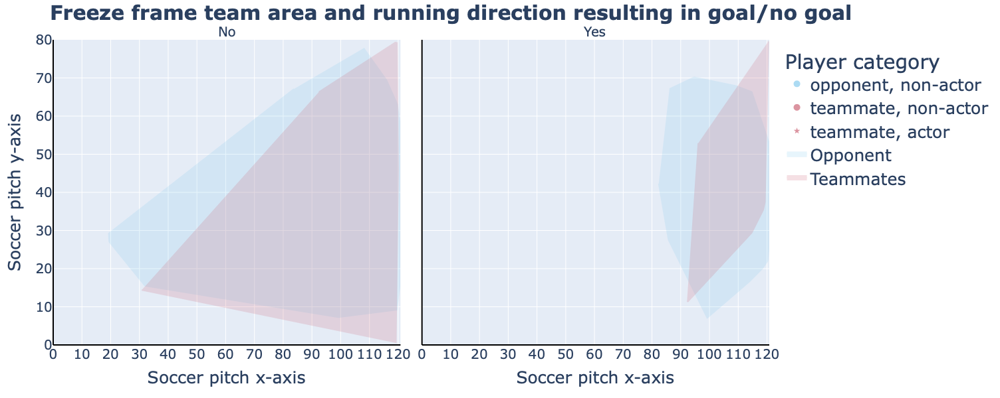

In [1535]:
fig = px.scatter(df_freeze_frame_event, x="location_x", y="location_y", color="teammate_category", symbol="actor_category", 
                 facet_col="goal", facet_col_wrap=4, facet_col_spacing=0.03, symbol_sequence=['circle', 'star'], 
                 size="marker_size", color_discrete_sequence=px.colors.qualitative.Safe, width=1600, height=600, trendline="ols") # ols, lowess

# x-axis
fig.update_xaxes(
    title="Soccer pitch x-axis",
    title_font_size=25,
    tickfont=dict(size=20),
    dtick=10,
    range=[0, 120.8],
    zerolinewidth=2, 
    zerolinecolor='black',
)

# y-axis
fig.update_yaxes(
    title="Soccer pitch y-axis",
    title_font_size=25,
    tickfont=dict(size=20),
    range=[0, 80],
    zerolinewidth=2, 
    zerolinecolor='black',
)

# lines width and marker size
#fig.update_traces(marker={'size': 5})

# legend
fig.update_layout(   
    legend=dict(
         title="Player category",
        yanchor="top",
        y=0.99,
        xanchor="left",
        font=dict(size=25),
))

# Add polygon to the 1st facet (opponent team)
fig.add_trace(
    go.Scatter(
        x=polygon_opponent_nogoal[:, 0], # x
        y=polygon_opponent_nogoal[:, 1], # y
        mode='lines',
        fill='toself',
        fillcolor=px.colors.qualitative.Safe[0],
        line=dict(color=px.colors.qualitative.Safe[0]),
        opacity=0.2,
        name='Opponent',
        showlegend=True,  # Hide from legend
        hoverinfo='skip'
    ),
    row=1, col=1 
)

# Add polygon to the 1st facet (teammates)
fig.add_trace(
    go.Scatter(
        x=polygon_teammate_nogoal[:, 0], # x
        y=polygon_teammate_nogoal[:, 1], # y
        mode='lines',
        fill='toself',
        fillcolor=px.colors.qualitative.Safe[1],
        line=dict(color=px.colors.qualitative.Safe[1]),
        opacity=0.2,
        name='Teammates',
        showlegend=True,  # Hide from legend
        hoverinfo='skip'
    ),
    row=1, col=1 
)

# Add polygon to the 2nd facet (opponent team)
fig.add_trace(
    go.Scatter(
        x=polygon_opponent_goal[:, 0], # x
        y=polygon_opponent_goal[:, 1], # y
        mode='lines',
        fill='toself',
        fillcolor=px.colors.qualitative.Safe[0],
        line=dict(color=px.colors.qualitative.Safe[0]),
        opacity=0.2,
        name='Opponent',
        showlegend=False,  # Hide from legend
        hoverinfo='skip'
    ),
    row=1, col=2 
)

# Add polygon to the 2nd facet (teammates)
fig.add_trace(
    go.Scatter(
        x=polygon_teammate_goal[:, 0], # x
        y=polygon_teammate_goal[:, 1], # y
        mode='lines',
        fill='toself',
        fillcolor=px.colors.qualitative.Safe[1],
        line=dict(color=px.colors.qualitative.Safe[1]),
        opacity=0.2,
        name='Teammates',
        showlegend=False,  # Hide from legend
        hoverinfo='skip'
    ),
    row=1, col=2 
)

# Update the polygon selector of the visible area (modify the first trace, which is the polygon)
fig.update_traces(selector=dict(type='scatter', mode='lines'))

# facet label
fig.for_each_annotation(lambda a: a.update(font=dict(size=20), text=a.text.split("=")[-1]))

# remove second yaxis title
fig.update_layout(yaxis2=dict(title=""))

fig.update_layout(
    font={'size': 25},
    title={'text': '<b>Freeze frame team area and running direction resulting in goal/no goal</b>', 'font': {'size': 30}}
)

fig.show()

fig.write_html("./figures/Freeze_frame_game_sitation_goal_vs_nogoal_polygon_trend.html", include_plotlyjs="cdn")

### Save/Load intermediate dataset consisting of all freeze frames information (to csv's)

In [1]:
#df_freeze_frame_event.to_csv("./intermediate_datasets/freeze_frames_event.csv")
##df_freeze_frame_event.to_json("./intermediate_datasets/freeze_frames_df_freeze_frame_event.json", orient='records')

In [1051]:
df_freeze_frame_event = pd.read_csv("./intermediate_datasets/freeze_frames_event.csv", index_col=0)

df_freeze_frame_event['y'] = df_freeze_frame_event['goal'].apply(lambda x: 1 if x == 'Yes' else 0)

print(f"DataFrame size: {df_freeze_frame_event.shape}")
df_freeze_frame_event.head()

DataFrame size: (22887, 12)


,event_uuid,teammate,actor,keeper,location_x,location_y,teammate_category,actor_category,keeper_category,goal,marker_size,y
6815,ca18ba8a-13ce-4287-aa81-0b02a0e2e4df,False,False,False,95.251147,43.113602,opponent,non-actor,player,No,10,0
6816,ca18ba8a-13ce-4287-aa81-0b02a0e2e4df,False,False,False,98.217912,28.002160,opponent,non-actor,player,No,10,0
6817,ca18ba8a-13ce-4287-aa81-0b02a0e2e4df,True,False,False,101.821481,38.905794,teammate,non-actor,player,No,10,0
6818,ca18ba8a-13ce-4287-aa81-0b02a0e2e4df,False,False,False,106.777983,36.508244,opponent,non-actor,player,No,10,0
6819,ca18ba8a-13ce-4287-aa81-0b02a0e2e4df,False,False,False,107.244791,41.116926,opponent,non-actor,player,No,10,0


In [1075]:
np.unique(df_freeze_frame_event.goal, return_counts=True)

(array(['No', 'Yes'], dtype=object), array([21024,  1863]))

### Define a classification model using the features of the 360 dataset (actor, location[x,y]) to determine whether a particular pattern leads to a goal

In [1219]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline

from sklearn.ensemble import RandomForestClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier

In [1227]:
# split in features and labels
#X = df_freeze_frame_event[['actor', 'teammate', 'keeper', 'location_x', 'location_y']]
X = df_freeze_frame_event[['actor', 'location_x', 'location_y']]
y = df_freeze_frame_event['y']

In [1229]:
# split the data in training and test data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

print(f"X: {X.shape} ; y: {y.shape}")
print(f"X_train: {X_train.shape} ; y_train: {y_train.shape}")
print(f"X_test: {X_test.shape} ; y_test: {y_test.shape}")

X: (22887, 3) ; y: (22887,)
X_train: (16020, 3) ; y_train: (16020,)
X_test: (6867, 3) ; y_test: (6867,)


In [1231]:
# define the classifiers to be tested
names = [
    "Nearest Neighbors",
    "RBF SVM",
    "XGBoost",
    "Random Forest",
    "Neural Net",
    "Naive Bayes",
]

classifiers = [
    KNeighborsClassifier(3),
    SVC(random_state=42),
    XGBClassifier(n_estimators=100, max_depth=100, learning_rate=1, objective='binary:logistic'),
    RandomForestClassifier(
        max_depth=100, n_estimators=100, random_state=42
    ),
    MLPClassifier(max_iter=1000, random_state=42),
    GaussianNB()
]

In [1251]:
%%time

# iterate over classifiers
for name, clf in zip(names, classifiers):   

    clf = make_pipeline(StandardScaler(), clf)
    clf.fit(X_train, y_train)

    print("Current classifier:", name)
    
    # predict the test data
    y_pred = clf.predict(X_test)
    
    # and evaluate the results evaluate
    print("Accuracy:", accuracy_score(y_test, y_pred))
    print(classification_report(y_test, y_pred))
    #print(confusion_matrix(y_test, y_pred))


Current classifier: Nearest Neighbors
Accuracy: 0.9027231687782147
              precision    recall  f1-score   support

           0       0.92      0.98      0.95      6317
           1       0.12      0.03      0.05       550

    accuracy                           0.90      6867
   macro avg       0.52      0.51      0.50      6867
weighted avg       0.86      0.90      0.88      6867

Current classifier: RBF SVM
Accuracy: 0.9199068006407456
              precision    recall  f1-score   support

           0       0.92      1.00      0.96      6317
           1       0.00      0.00      0.00       550

    accuracy                           0.92      6867
   macro avg       0.46      0.50      0.48      6867
weighted avg       0.85      0.92      0.88      6867



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


Current classifier: XGBoost
Accuracy: 0.8814620649483035
              precision    recall  f1-score   support

           0       0.92      0.95      0.94      6317
           1       0.14      0.09      0.11       550

    accuracy                           0.88      6867
   macro avg       0.53      0.52      0.52      6867
weighted avg       0.86      0.88      0.87      6867

Current classifier: Random Forest
Accuracy: 0.9169943206640454
              precision    recall  f1-score   support

           0       0.92      0.99      0.96      6317
           1       0.33      0.04      0.07       550

    accuracy                           0.92      6867
   macro avg       0.63      0.52      0.51      6867
weighted avg       0.87      0.92      0.89      6867

Current classifier: Neural Net
Accuracy: 0.9199068006407456
              precision    recall  f1-score   support

           0       0.92      1.00      0.96      6317
           1       0.00      0.00      0.00       550

  

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


### Conclusion on the application of machine learning models

- Characteristics were the position of the players, their team affiliation, which player is the actor and which player is the goalkeeper
- All models are good at recognizing whether a goal is scored based on the position of the active player
- In the same way, however, all models have problems using these characteristics to find out when goals are scored, and since this event accounts for a fractional and thus under-representative part after corners, this analysis does not add any value

## c. Summarize your recommendations to the Set-Piece coach.

In [3]:
from IPython.display import display, HTML

In [5]:
with open('./figures/Corner_shot_w-wo_goal.html', 'r') as file:
    Corner_shot_w_wo_goal_html = file.read()

with open('./figures/Corner_pass_technique_height.html', 'r') as file:
    Corner_pass_technique_height = file.read()

with open('./figures/Corner_pass_w_wo_goal_box.html', 'r') as file:
    Corner_pass_w_wo_goal_box = file.read()

with open('./figures/Corner_pass_length_and_angle_box.html', 'r') as file:
    Corner_pass_length_and_angle_box = file.read()

with open('./figures/Corner_pass_angle_polar.html', 'r') as file:
    Corner_pass_angle_polar = file.read()

with open('./figures/Corner_pass_end_location.html', 'r') as file:
    Corner_pass_end_location = file.read()

with open('./figures/Freeze_frame_game_sitation_goal_vs_nogoal.html', 'r') as file:
    Freeze_frame_game_sitation_goal_vs_nogoal = file.read()

with open('./figures/Freeze_frame_game_sitation_goal_vs_nogoal_polygon_trend.html', 'r') as file:
    Freeze_frame_game_sitation_goal_vs_nogoal_polygon_trend = file.read()

### Offensive recommendation based on Trend 1: Direct shots on goal from the corner

Of all the shots on goal counted across all events, 28 were direct shots on goal from a corner (**see Figure "Direct corner with/without goal"**).<br>
- From these, 10 shots were a goal, which is more than 35%, whether it was a coincidence or not.
- This strategy is recommended simply because it has an absolute surprise effect and nobody expects it.
- The goalkeeper does not usually expect this and therefore does not position himself so close to the baseline.

**In this case, it requires a training for a corner kick with spin and an inswinging corner, as only this is able to fly from the corner directly into the goal.**

In [8]:
display(HTML(Corner_shot_w_wo_goal_html))

### Offensive recommendation based on Trend 2: Finding corner passes with a successful shooting technique and appropriate height of the pass

The statistics show that corner kicks:
- from a through ball have never led to a goal and
- straight balls have led to a goal in the fewest cases (61x for high passes and 5x for low passes) (**see Figure "Corner pass technique and pass height"**)<br>
- The most successful passes to score goals are the inswinging corner kicks with 458x for high passes and 12x for low passes
- Slightly poor cut outswinging corner kicks with 402x for high passes and 8x for low passes

**This leads to the conclusion that corners should be trained to be shot high and inswinging.**

Similar statistics can be derived from the angle, but this depends only slightly on whether the corner was shot inswinging or outswinging.<br>
The bimodal distribution of angles in the range of -1.6 degrees or +1.6 degrees indicates whether the corner was shot from the left or right corner as seen from the goal.

In [13]:
display(HTML(Corner_pass_technique_height))

### Offensive recommendation based on Trend 3: Finding corner passes with successful pass length and angle

The statistics for the length and angle of corner kicks are as follows:
- there is no difference in which length or angle the corner is shot in relation to the goal success (**see Figures below**)<br>
- even for the most promising scenario above with inswingig pass, there is no significant goal success (p-value < 0.94)
- on average, after inswinging corner passes are shot about half a meter shorter before they are used for a goal finish (**see 2 Figures below**)

**Nevertheless, it can be stated that most corners with a length between 34m - 43m and an average of 39.5m led to a goal.
This pass length should be practiced.<br>**
**Inswinging corners should be trained to be half a meter shorter (39.5m) than outswinging corners (40.2m on average).**

In [19]:
display(HTML(Corner_pass_w_wo_goal_box))

In [23]:
display(HTML(Corner_pass_length_and_angle_box))

In [1555]:
display(HTML(Corner_pass_angle_polar))

### Offensive recommendation based on Trend 4: Determination of the (x,y) positions from which the corner kick comes to a goal finish 

The points shown here represent the target coordinates where the ball arrived before the game situation led to a goal (**see Figure "End location of corner pass before goal play pattern"**):<br>

- The lines mark a linear trend across all of the corner techniques (inswinging, outswinging, straight) and can give an indication of the player's running path in practice
- For example, after an outswinging corner, the player should run from the short post towards the long post (even if the reaction time here is very short)
- A slight offset on the x-axis of the pitch with regard to the rectange can be seen in the most successful of the three shooting techniques, in that the players are closer to the goal on inswinging corners

**Here, the running direction and, if necessary, a change of direction at a corner should be practiced, as well as winning the ball when the attacking player is positioned closer to the goal.<br>**
**It is important to position players precisely in the area where all 3 rectangles overlap, as this is where there is the highest chance of scoring a goal in relation to the positioning of the attacking player.**

In [174]:
display(HTML(Corner_pass_end_location))

### Defensive recommendation based on freeze frame analysis 1: Search for the area in which the player is most likely to score goals

The interactive mode in plotly-visualizations allows the viewer to take a closer look at specific areas of the graphic (**see Figure "Freeze frame player position resulting in goal/no goal"**).<br>
The following observations can be made when deactivating non-actor teammates (click on *<teammate, non-actor>* in the legend):
- From the baseline to the 11m point, the vast majority of (actor) players who were successful with their shot on goal after a corner are positioned lengthways
- The same applies in the cross direction for the 5-meter area, where most of the successful goal scorers are located
- Conversely, for the unsuccessful scorers, as soon as the player of the freeze frame is positioned outside the 16-meter area, this does not represent a danger and therefore the area outside the 16-meter area can be disregarded

**The training should focus in particular on defensive behavior, especially winning the header duel and positioning in the goalkeeper area.**

In [34]:
display(HTML(Freeze_frame_game_sitation_goal_vs_nogoal))

### Defensive recommendation based on freeze frame analysis 2: Search for the running direction in the area where the player is most likely to score goals

The interactive mode in Plotly allows the viewer to take a closer look at certain areas and trend lines of the graph (**see Figure "Freeze frame team area and running direction resulting in goal/no goal"**).<br>

The following observations can be made when (de)activating non-actor teammates (click on *<teammate, non-actor>* in the legend):
- The polygons in the figures highlights the area where the actor player of the attacking team and the area of the defending team are located
- The trend curve for all actors of the attacking team show a diagonal alignment from one post to the other after a successful goal following a corner kick, which is possibly also an indication of the running path of the goal scorer
- At the same time, the trend line of all players of the attacking team who were not involved in the goal kick itself (teammate, non-actor) shows that it is at right angles to the baseline
- This alignment (and possibly the running path) is almost at right angles to the baseline for the players who have taken the shot on goal after a corner and this did not lead to a successful goal
- If only attacking players after a successful goal and players of the defending team are considered, it is also noticeable here, as in the previous graphic, that defensive players outside the 16-meter area are far away from the goal scorer

**For training purposes, the defensive players in the goalkeeper area in particular should win the overhead battle and in the area within the red-colored polygons.<br>**
**The alignment (and, if necessary, the direction of running) of the defending players should be concentrated diagonally in the box against the direction of the corner kicker.**

In [1539]:
display(HTML(Freeze_frame_game_sitation_goal_vs_nogoal_polygon_trend))

### Defensive recommendation based on freeze frame Machine Learning-based analysis: Machine learning for optimal positioning of players

- Characteristics were the position of the players, their team affiliation, which player is the actor and which player is the goalkeeper
- All models are good at recognizing whether **no** goal is scored based on the position of the active player
- In the same way, however, all models have problems using these characteristics to find out when goals are scored, and since this event accounts for a fractional and thus under-representative part after corners, this analysis does not add any value

**Unfortunately, the results did not provide any clear training recommendations.**

### Concluding remarks: 

The recommendations to the Set-Piece coach shown here are based on analyses of all corner kicks that led to a goal / did not lead to a goal.<br>
Further insights can be gained by analyzing individual scenarios of a freeze frame and identifying patterns as to where which players should be positioned. 

The analysis carried out here indicates that corner kicks that are inswinging are the most successful for the attacking team.
The defensive team can prepare for this statistically greatest scoring threat when a right-footed player shoots from the right corner (from their own goal's perspective), as in this case the corner is most likely to be inswinging.
This analysis also shows the alignment as well as an indicator for the running path of the offensive and defensive players, which are statistically most likely to lead to goal success/goal miss.